# 01 Introduction to Pytesseract
**Google Colab Notebook for OCR using Pytesseract**


*   https://bhadreshpsavani.medium.com/how-to-use-tesseract-library-for-ocr-in-google-colab-notebook-5da5470e4fe0

*   https://nanonets.com/blog/ocr-with-tesseract/





# 02 Installation


*   install tesseract-ocr on linux  เเละ libtesseract-dev เพื่อใช้ command line on terminal
*   install pytesseract สำหรับการเขียนด้วย ภาษา python
*   **install tesseract-ocr-tha for thai **




**หมายเหตุ ** ใน colab ต้อง install ใหม่ทุกครั้ง เเละหลังจาก install ด้วย cell ด้านล่างจำเป็นต้อง Restart Runtime ใหม่



In [ ]:
!apt install tesseract-ocr
!apt-get install tesseract-ocr-tha
!apt install libtesseract-dev
! pip install pytesseract
 # restart runtime

Reading package lists... Done
Building dependency tree       
Reading state information... Done
The following packages were automatically installed and are no longer required:
  cuda-command-line-tools-10-0 cuda-command-line-tools-10-1
  cuda-command-line-tools-11-0 cuda-compiler-10-0 cuda-compiler-10-1
  cuda-compiler-11-0 cuda-cuobjdump-10-0 cuda-cuobjdump-10-1
  cuda-cuobjdump-11-0 cuda-cupti-10-0 cuda-cupti-10-1 cuda-cupti-11-0
  cuda-cupti-dev-11-0 cuda-documentation-10-0 cuda-documentation-10-1
  cuda-documentation-11-0 cuda-documentation-11-1 cuda-gdb-10-0 cuda-gdb-10-1
  cuda-gdb-11-0 cuda-gpu-library-advisor-10-0 cuda-gpu-library-advisor-10-1
  cuda-libraries-10-0 cuda-libraries-10-1 cuda-libraries-11-0
  cuda-memcheck-10-0 cuda-memcheck-10-1 cuda-memcheck-11-0 cuda-nsight-10-0
  cuda-nsight-10-1 cuda-nsight-11-0 cuda-nsight-11-1 cuda-nsight-compute-10-0
  cuda-nsight-compute-10-1 cuda-nsight-compute-11-0 cuda-nsight-compute-11-1
  cuda-nsight-systems-10-1 cuda-nsight-systems-

#03 Load Example Image file

*   upload image file ด้วย google.colab.files.upload
*   download file exmaple ที่ link ... ([link images](https://drive.google.com/drive/folders/14lap7HCmM7TjSnyfQS0ptL7lIzchk8TM?usp=sharing)) เลือกไฟล์ **thai_2.JPG**


In [ ]:
from google.colab import files
uploaded = files.upload()

Saving thai_2.JPG to thai_2.JPG


In [ ]:
! ls

sample_data  thai_2.JPG


## **load and show input image**

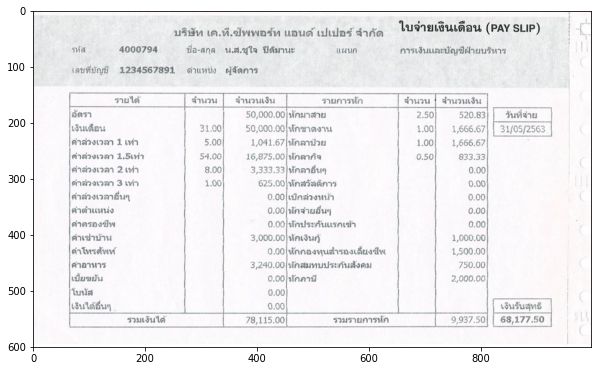

In [ ]:
import numpy as np
import cv2
import matplotlib.pyplot as plt

image = cv2.imread("thai_2.JPG")
image = image[..., ::-1]

plt.figure(figsize=(10,10))
plt.imshow(image)

# 04 OCR Tesseract Functions
โดยเเต่ละฟังก์ชันจะระบุพารามิเตอร์ภาษา lang='tha'
เช่น pytesseract.image_to_string(image, lang="tha")

## 4.1 **image_to_string** Text Extraction การดึงข้อความ

In [ ]:
import pytesseract
image = cv2.imread("thai_2.JPG")
results = pytesseract.image_to_string(image, lang="tha")
results

' \n\nบริษัท เค.ที.ซัพพเอร์ท แอนด์ เปเปอร์ จํากัด\n\nใบจ่ายเงฉินเดือน (อล” ธน6)\n\n \n\n \n\n \n\n \n\n \n\n \n\n \n\n \n\n \n\nรหัส         4000794       ชื่อ-สกุล น.ส.ซูใจ ปีดิมานะ           แผนก           การเงินและบัญชีฝ่ายบริหาร\nเลขที่บัญชี 1234567891 ดําแหน่ง ผู้จัดการ\nรายได้             จํานวน [ จํานวนเงิน            รายการหัก           ลํานวน [ จํานวนเงิน\nอัตรา                                        50,000.00|หัคมาสาย                       2.50|       520.83| | วันที่จ่าย\nเงินเดือน                        31.00| 50,000.00|หักขาดงาน                      1.00| 1666.67| | 3บ05/2563\nคําล่วงเวลา 1 เท่า                 5.00        1.041.67|หัคลาป่วย                       1.00| 1,666.67\nค่าล่วงเวลา 1.5เท่า              54.00| 16,875.00| หักลากิจ                        0.50|( 833.33\nค่าล่วงเวลา 2 เท่า                 8.00        3,333.33|หัคลาอื่นๆ                                     0.00|\nค่าส่วงเวลา 3 เท่า                      1.00            625.00|หักสวัสดิการ               

In [ ]:
lines = results.split('\n')
for text in lines:
    print(text)

 

บริษัท เค.ที.ซัพพเอร์ท แอนด์ เปเปอร์ จํากัด

ใบจ่ายเงฉินเดือน (อล” ธน6)

 

 

 

 

 

 

 

 

 

รหัส         4000794       ชื่อ-สกุล น.ส.ซูใจ ปีดิมานะ           แผนก           การเงินและบัญชีฝ่ายบริหาร
เลขที่บัญชี 1234567891 ดําแหน่ง ผู้จัดการ
รายได้             จํานวน [ จํานวนเงิน            รายการหัก           ลํานวน [ จํานวนเงิน
อัตรา                                        50,000.00|หัคมาสาย                       2.50|       520.83| | วันที่จ่าย
เงินเดือน                        31.00| 50,000.00|หักขาดงาน                      1.00| 1666.67| | 3บ05/2563
คําล่วงเวลา 1 เท่า                 5.00        1.041.67|หัคลาป่วย                       1.00| 1,666.67
ค่าล่วงเวลา 1.5เท่า              54.00| 16,875.00| หักลากิจ                        0.50|( 833.33
ค่าล่วงเวลา 2 เท่า                 8.00        3,333.33|หัคลาอื่นๆ                                     0.00|
ค่าส่วงเวลา 3 เท่า                      1.00            625.00|หักสวัสดิการ                                           0.00|

## 4.2 **image_to_boxes** Text Location การหาตำเเหน่งข้อความ

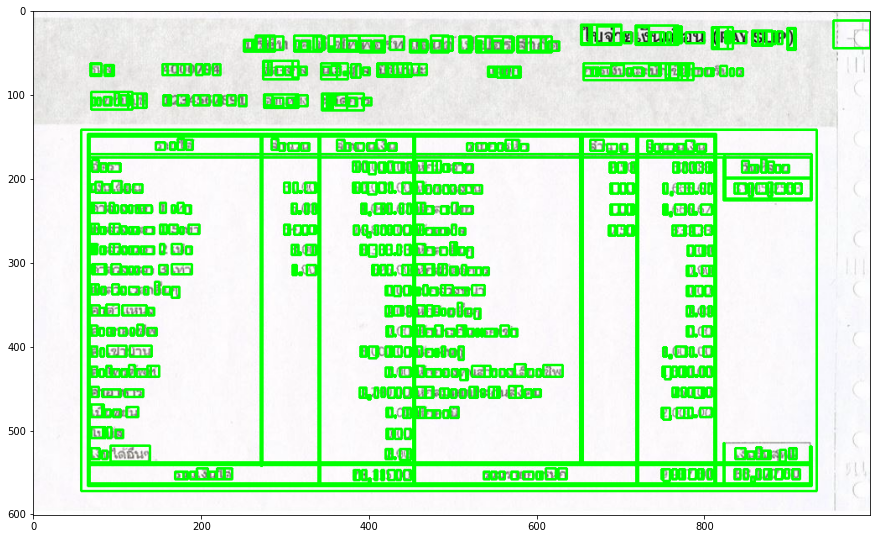

In [ ]:
import pytesseract

iimage = cv2.imread("thai_2.JPG")
h, w, c = image.shape
boxes = pytesseract.image_to_boxes(image, lang='tha')
for b in boxes.splitlines():
    b = b.split(' ')
    image = cv2.rectangle(image, (int(b[1]), h - int(b[2])), (int(b[3]), h - int(b[4])), (0, 255, 0), 2)
plt.figure(figsize=(15,15))
plt.imshow(image)


## 4.3 **image_to_data** การดึงข้อมูลประกอบ

'level', 'page_num', 'block_num', 'par_num', 'line_num', 'word_num', 'left', 'top', 'width', 'height', 'conf', 'text'

In [ ]:
from pytesseract import Output

image = cv2.imread("thai_2.JPG")
d = pytesseract.image_to_data(image, lang='tha', output_type=Output.DICT)
for i in range(len(d['text'])):
    if float(d['conf'][i]) < 0.6 and len(d['text'][i]) == 0:
        continue
    left, top, width, height = d['left'][i], d['top'][i], d['width'][i], d['height'][i]
    print((d['text'][i]))


 
บ
ร
ิ
ษั
ท
เค
.
ท
ี
.
ซ
ั
พ
พ
เอ
ร
์
ท
แอ
น
ด
์
เป
เป
อ
ร
์
จ
ํ
า
ก
ั
ด
ใบ
จ
่
า
ย
เง
ฉิ
น
เด
ื
อ
น
(อ
ล
”
ธน
6)
 
 
 
 
 
 
 
 
 
ร
ห
ั
ส
4000794
ชื
่
อ
-
ส
ก
ุ
ล
น
.
ส
.
ซ
ู
ใจ
ป
ี
ด
ิ
ม
า
น
ะ
แผ
น
ก
ก
า
ร
เง
ิ
น
แล
ะ
บ
ั
ญ
ชี
ฝ่า
ย
บ
ร
ิ
ห
า
ร
เล
ข
ท
ี
่
บ
ั
ญ
ชี
1234567891
ด
ํ
า
แห
น
่
ง
ผู
้
จ
ั
ด
ก
า
ร
ร
า
ย
ได
้
จ
ํ
า
น
ว
น
[
จ
ํ
า
น
ว
น
เง
ิ
น
ร
า
ย
ก
า
ร
ห
ั
ก
ล
ํ
า
น
ว
น
[
จ
ํ
า
น
ว
น
เง
ิ
น
อ
ั
ต
ร
า
50,000.00|
ห
ั
ค
ม
า
ส
า
ย
2.50|
520.83|
|
ว
ั
น
ท
ี
่
จ
่
า
ย
เง
ิ
น
เด
ื
อ
น
31.00|
50,000.00|
ห
ั
ก
ขา
ด
ง
า
น
1.00|
1666.67|
|
3
บ
05/2563
ค
ํ
า
ล
่
ว
ง
เว
ล
า
1
เท
่
า
5.00
1.041.67|
ห
ั
ค
ล
า
ป
่
ว
ย
1.00|
1,666.67
ค
่
า
ล
่
ว
ง
เว
ล
า
1.5
เ
ท
่
า
54.00|
16,875.00|
ห
ั
ก
ล
า
ก
ิ
จ
0.50|(
833.33
ค
่
า
ล
่
ว
ง
เว
ล
า
2
เท
่
า
8.00
3,333.33|
ห
ั
ค
ล
า
อ
ื
่
น
ๆ
0.00|
ค
่
า
ส
่
ว
ง
เว
ล
า
3
เท
่
า
1.00
625.00|
ห
ั
ก
ส
ว
ั
ส
ด
ิ
ก
า
ร
0.00|
ค
ํ
า
ล
่
ว
ง
เว
ล
า
อ
ื
่
น
0.00|
เ
บ
ิ
ค
ล
่
ว
ง
ห
น
้
า
0.00
ค
ํ
า
ต
ํ
า
แห
น
่
ง
0.00|
ห
ั
ค
จ
่
า
ย
อ
ื
่
น
ๆ
0.00
ค
่
า
ค
ร
อ
ง
ซี


In [ ]:
d.keys()

dict_keys(['level', 'page_num', 'block_num', 'par_num', 'line_num', 'word_num', 'left', 'top', 'width', 'height', 'conf', 'text'])

## 4.4 เเสดงผลข้อความที่ Confident สูง

1   65 147 2 419


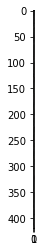

1 บ 0 0 998 601


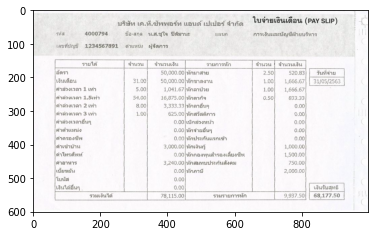

1 ร 252 36 12 11


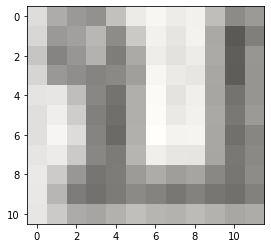

1 ิ 266 31 10 16


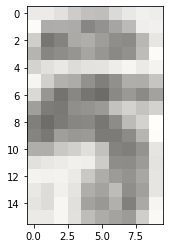

2 ษั 277 31 27 16


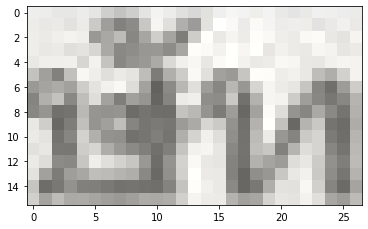

1 ท 0 0 998 601


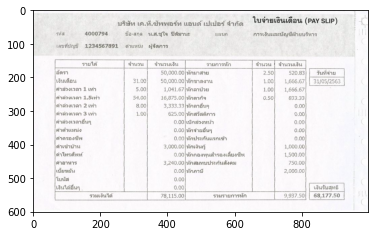

2 เค 312 36 18 11


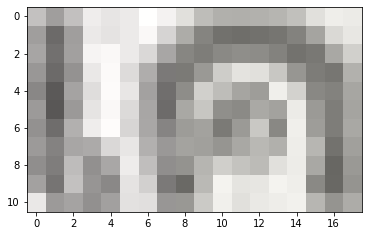

1 . 0 0 998 601


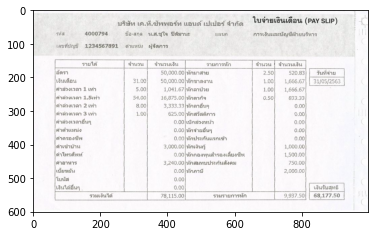

1 ท 332 43 4 4


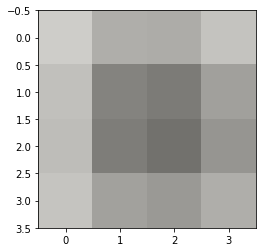

1 ี 338 31 13 16


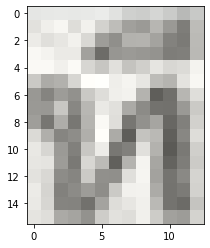

1 . 353 43 4 4


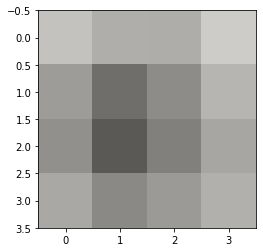

1 ซ 358 31 16 16


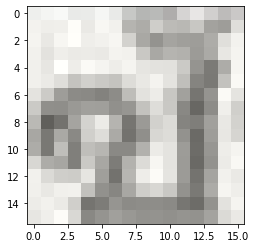

1 ั 0 0 998 601


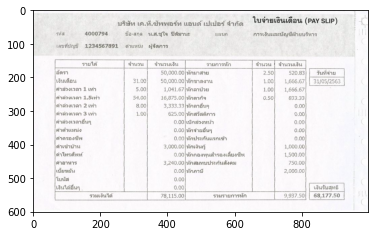

1 พ 374 36 14 11


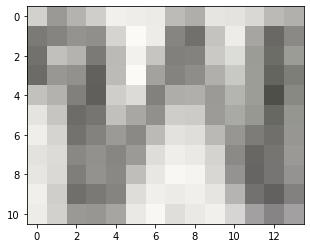

1 พ 0 0 998 601


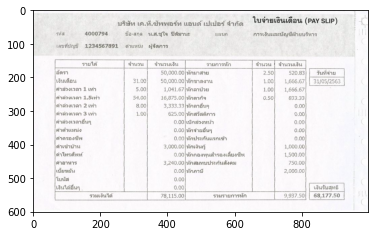

2 เอ 390 36 27 12


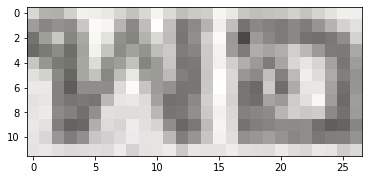

1 ร 0 0 998 601


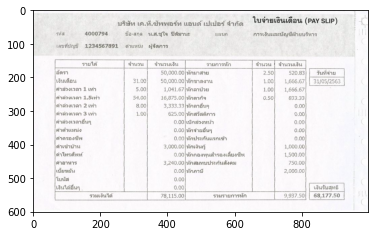

1 ์ 419 31 13 16


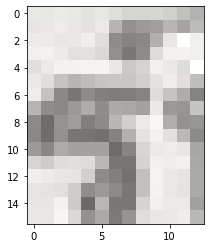

1 ท 429 36 13 11


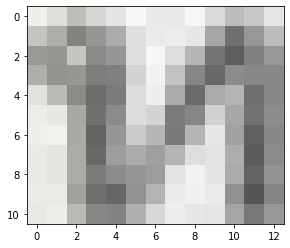

2 แอ 450 36 23 12


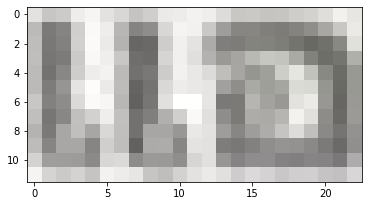

1 น 0 0 998 601


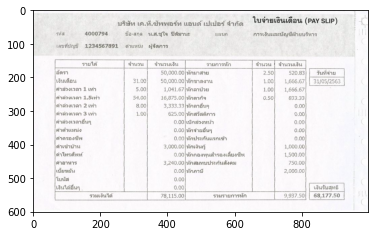

1 ด 475 36 12 12


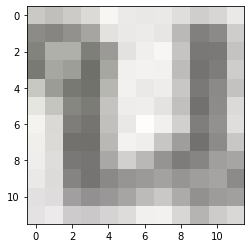

1 ์ 488 31 17 17


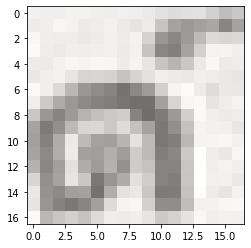

2 เป 509 32 18 16


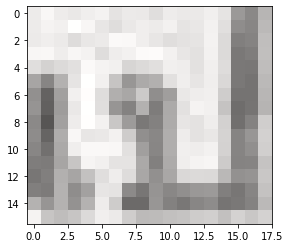

2 เป 529 36 5 12


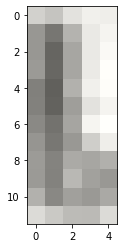

1 อ 535 32 12 16


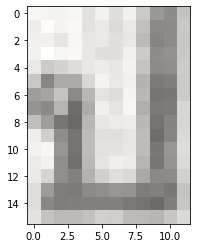

1 ร 548 36 11 12


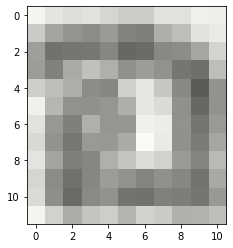

1 ์ 560 32 14 16


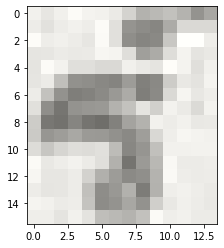

1 จ 0 0 998 601


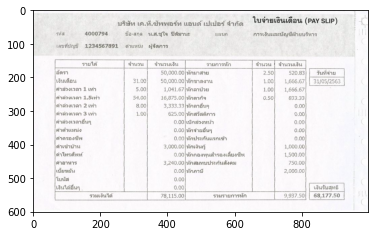

1 ํ 578 32 10 16


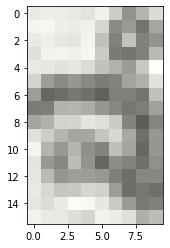

1 า 590 37 9 11


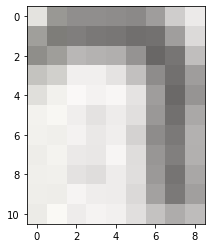

1 ก 0 0 998 601


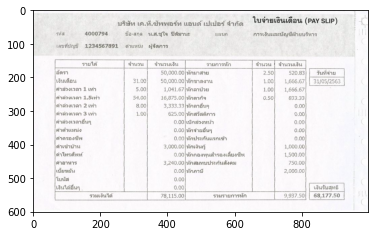

1 ั 601 32 14 16


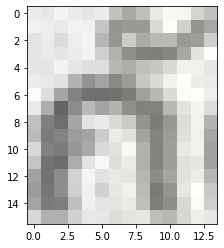

1 ด 614 37 13 11


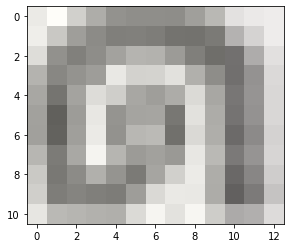

2 ใบ 654 18 12 21


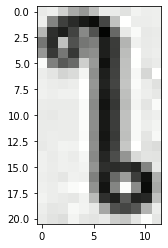

1 จ 666 25 14 14


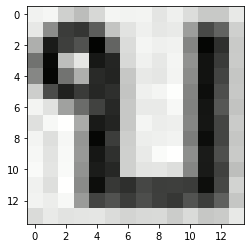

1 ่ 0 0 998 601


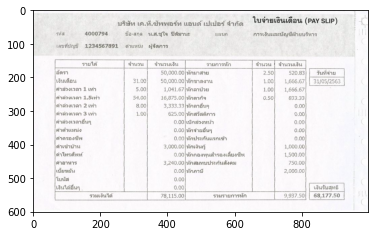

1 า 681 19 21 20


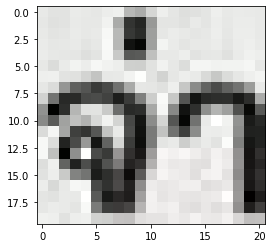

1 ย 704 26 12 13


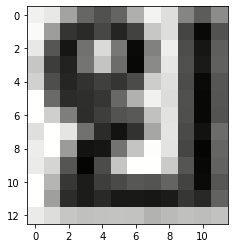

2 เง 719 26 6 13


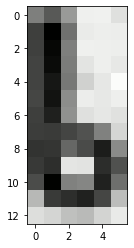

2 ฉิ 724 20 11 19


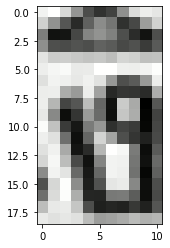

1 น 736 26 16 13


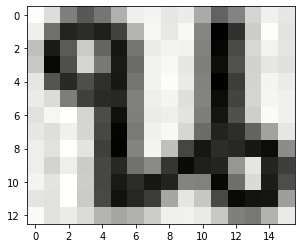

2 เด 753 19 20 20


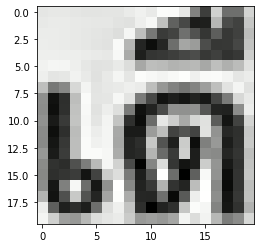

1 ื 0 0 998 601


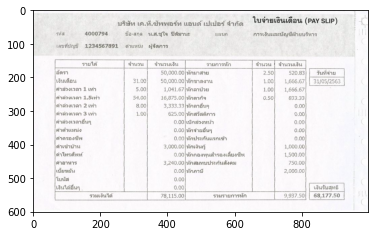

1 อ 774 26 12 13


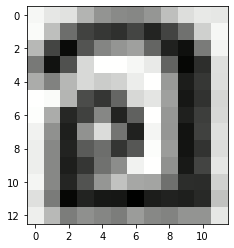

1 น 787 26 16 13


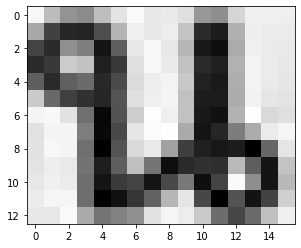

2 (อ 810 21 21 23


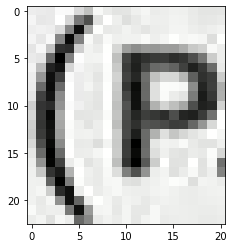

1 ล 830 25 13 14


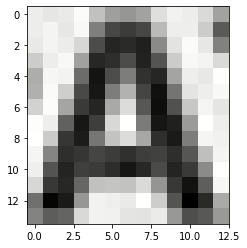

1 ” 842 25 11 14


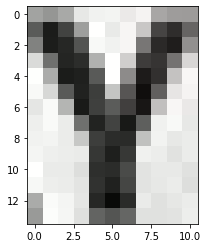

2 ธน 858 25 28 15


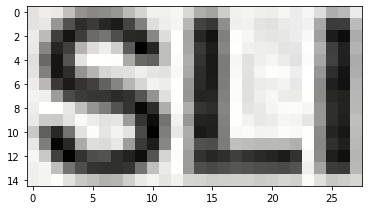

2 6) 887 22 20 23


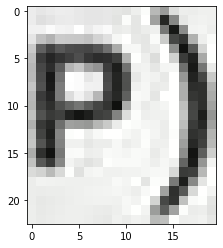

1   65 147 749 3


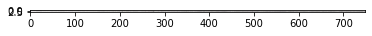

1   65 171 863 4


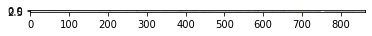

1   271 148 2 394


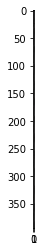

1   652 149 3 392


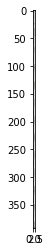

1   823 199 105 1


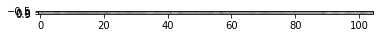

1   823 174 2 51


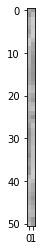

1   927 174 1 52


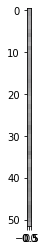

1   823 224 105 2


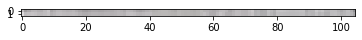

1   65 538 863 3


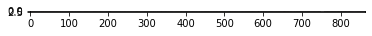

1 ร 0 0 998 601


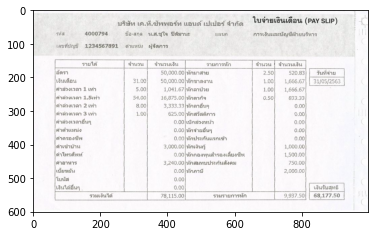

1 ห 69 64 15 12


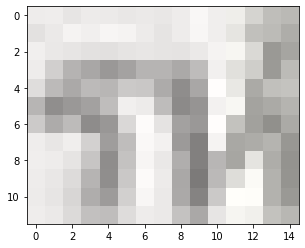

1 ั 0 0 998 601


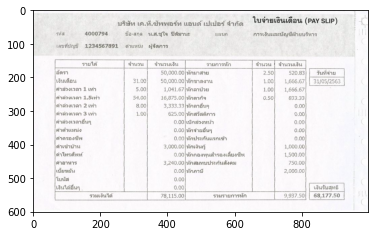

1 ส 86 66 8 10


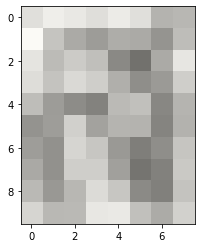

7 4000794 154 64 69 13


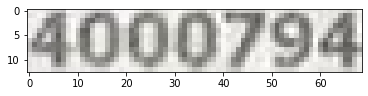

2 ชื 275 61 9 16


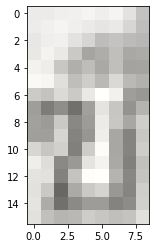

1 ่ 0 0 998 601


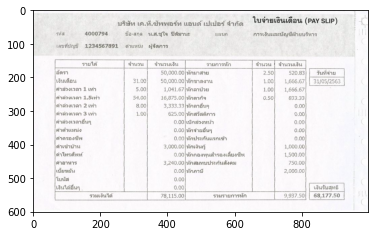

1 อ 285 67 8 10


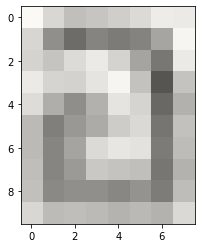

1 - 294 71 5 2


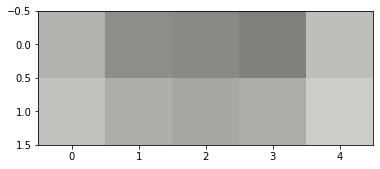

1 ส 300 67 8 10


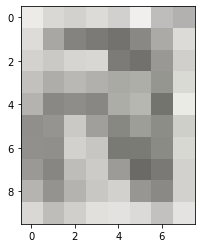

1 ก 309 67 8 13


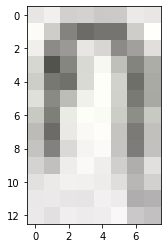

1 ุ 0 0 998 601


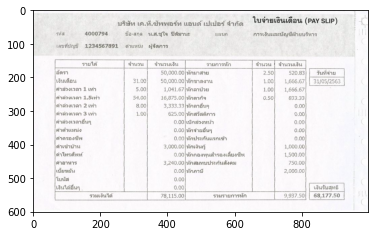

1 ล 318 67 8 10


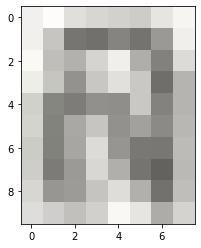

1 น 0 0 998 601


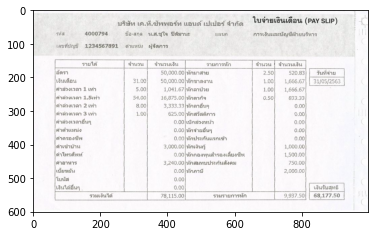

1 . 344 67 10 10


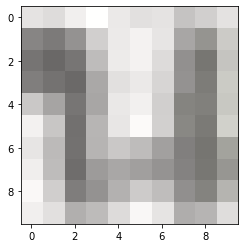

1 ส 355 66 14 11


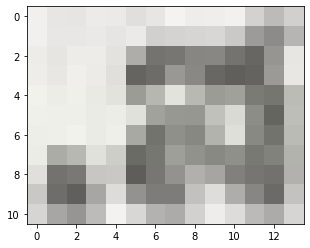

1 . 370 73 3 4


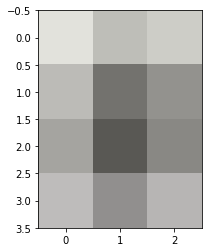

1 ซ 0 0 998 601


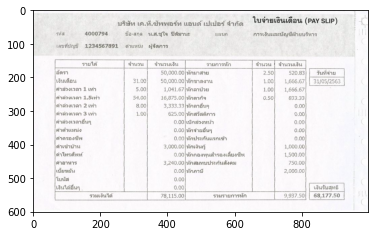

1 ู 374 64 19 16


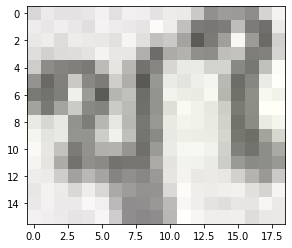

2 ใจ 393 68 8 9


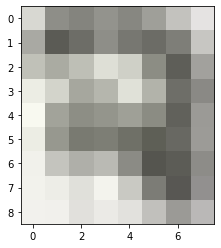

1 ป 0 0 998 601


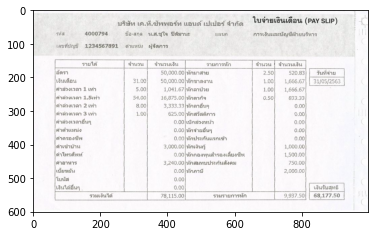

1 ี 411 64 10 13


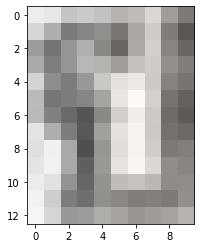

1 ด 0 0 998 601


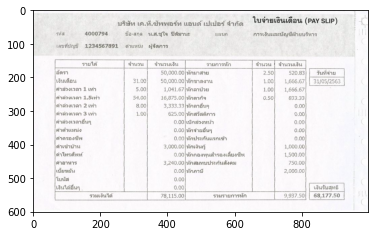

1 ิ 0 0 998 601


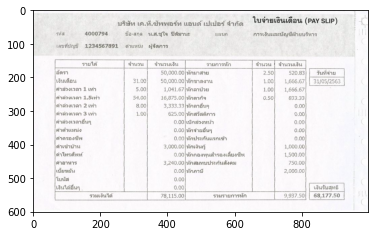

1 ม 0 0 998 601


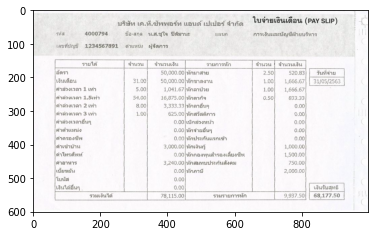

1 า 423 64 46 13


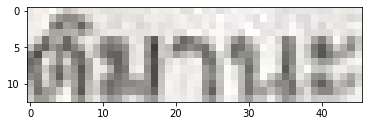

1 น 0 0 998 601


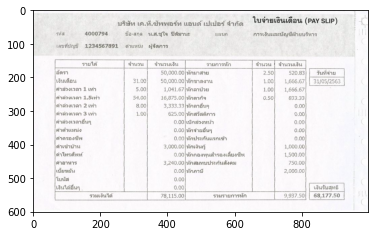

1 ะ 0 0 998 601


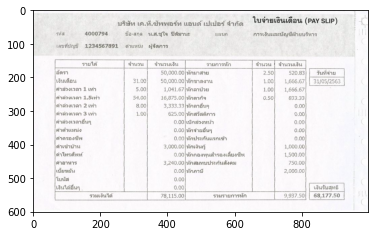

2 แผ 543 68 7 9


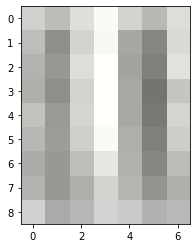

1 น 553 68 18 10


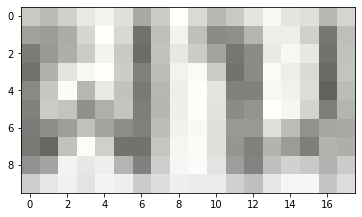

1 ก 572 68 7 10


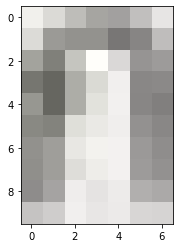

1 ก 0 0 998 601


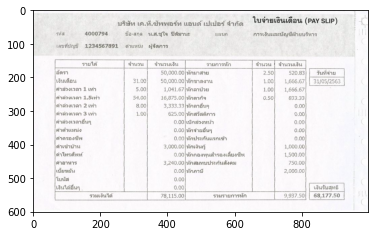

1 า 657 68 10 10


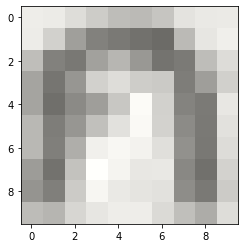

1 ร 667 68 7 10


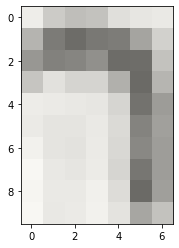

2 เง 675 68 13 10


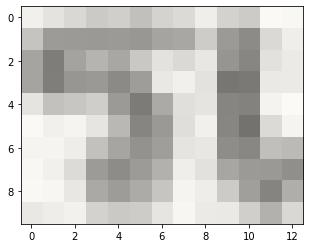

1 ิ 689 65 8 13


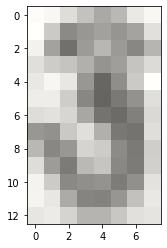

1 น 697 69 10 9


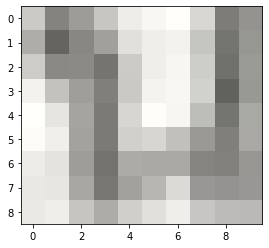

2 แล 708 68 10 10


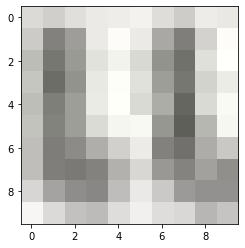

1 ะ 719 69 9 9


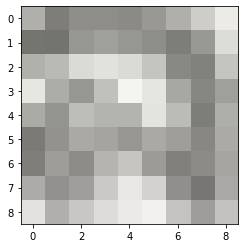

1 บ 729 65 19 13


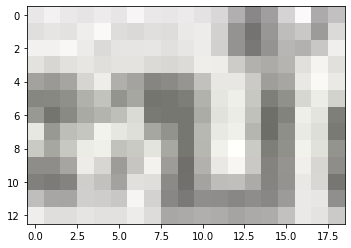

1 ั 0 0 998 601


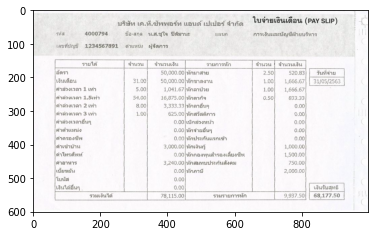

1 ญ 0 0 998 601


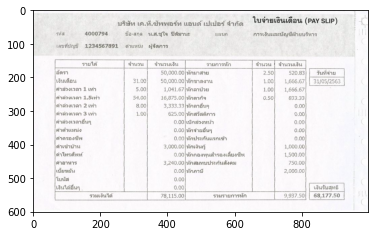

2 ชี 747 64 25 17


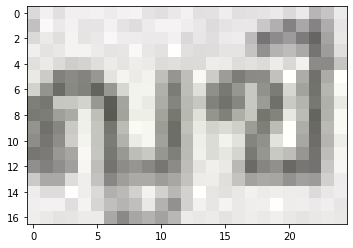

3 ฝ่า 772 65 18 13


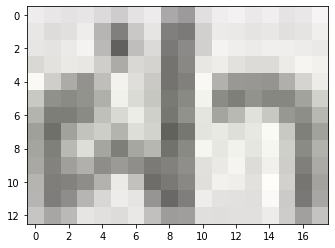

1 ย 792 69 8 9


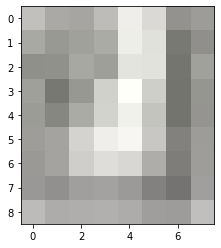

1 บ 0 0 998 601


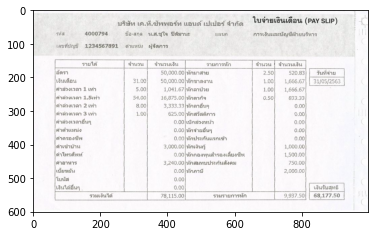

1 ร 801 69 10 9


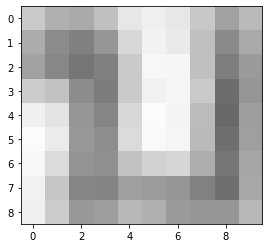

1 ิ 812 66 18 12


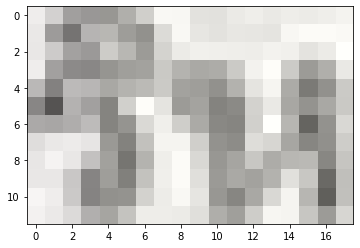

1 ห 0 0 998 601


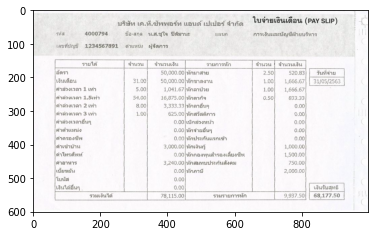

1 า 0 0 998 601


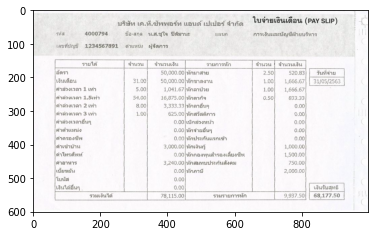

1 ร 831 69 15 9


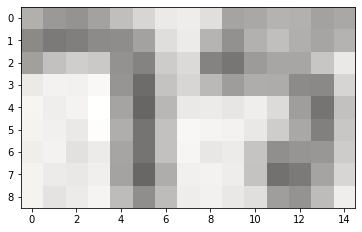

2 เล 70 104 13 9


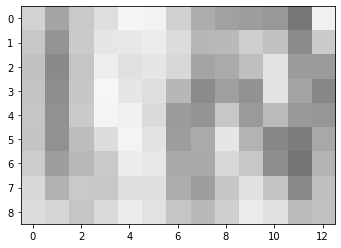

1 ข 0 0 998 601


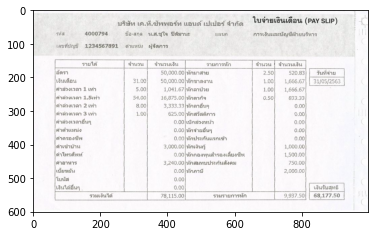

1 ท 84 103 9 10


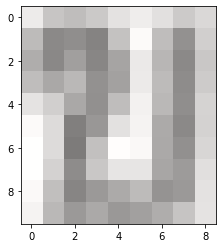

1 ี 94 98 10 15


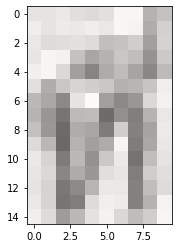

1 ่ 0 0 998 601


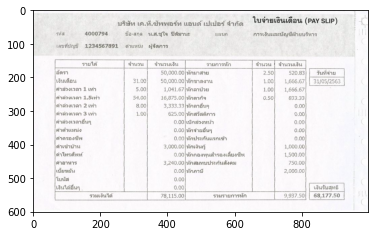

1 บ 104 101 11 12


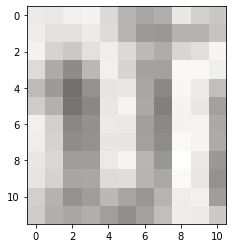

1 ั 0 0 998 601


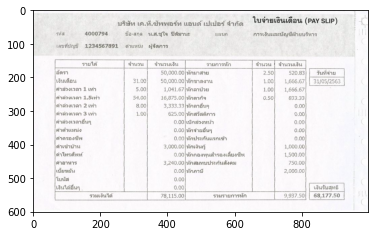

1 ญ 114 99 21 17


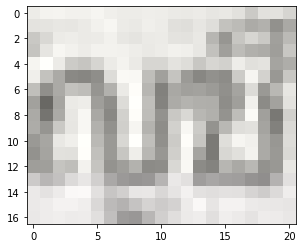

2 ชี 0 0 998 601


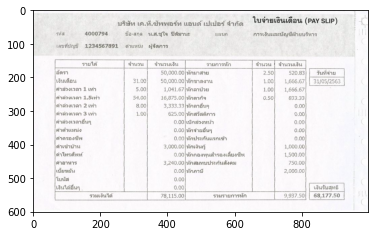

10 1234567891 155 101 99 13


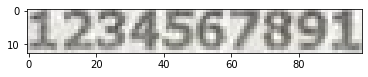

1 ด 0 0 998 601


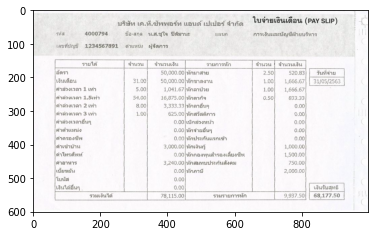

1 ํ 276 101 9 12


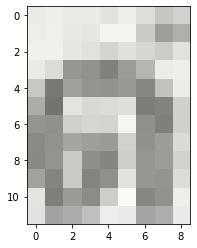

1 า 286 104 6 9


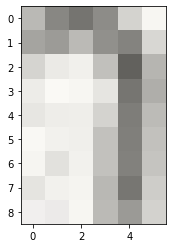

2 แห 293 104 18 10


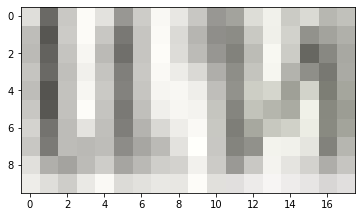

1 น 0 0 998 601


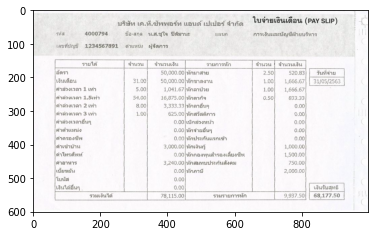

1 ่ 0 0 998 601


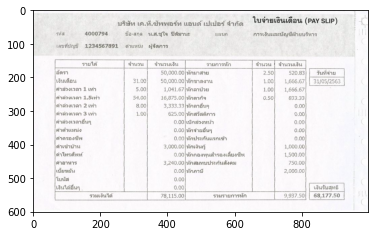

1 ง 312 101 15 13


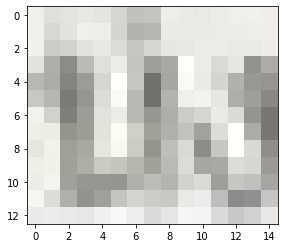

2 ผู 0 0 998 601


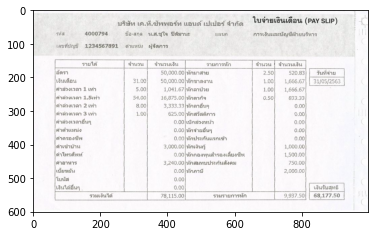

1 ้ 345 100 12 17


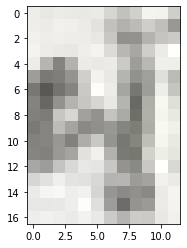

1 จ 356 100 11 13


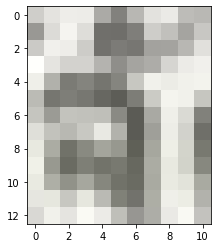

1 ั 0 0 998 601


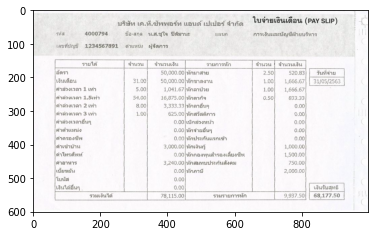

1 ด 366 104 9 9


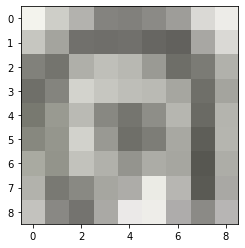

1 ก 376 104 10 10


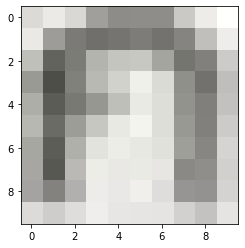

1 า 0 0 998 601


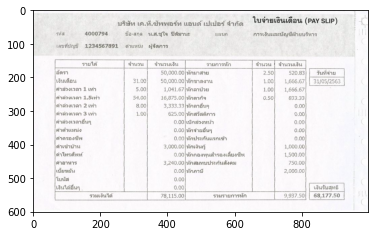

1 ร 387 104 16 9


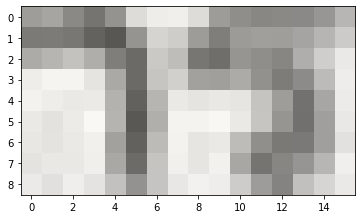

1 ร 0 0 998 601


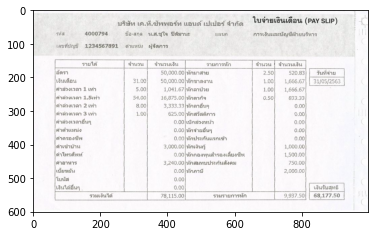

1 า 146 157 15 9


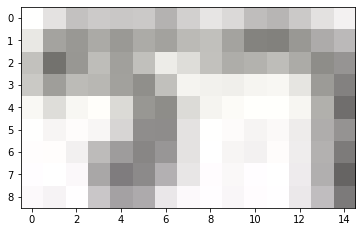

1 ย 0 0 998 601


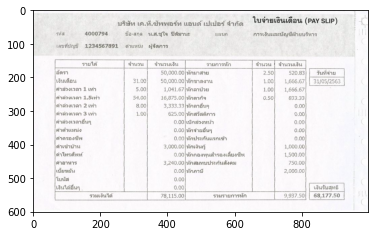

2 ได 163 153 17 13


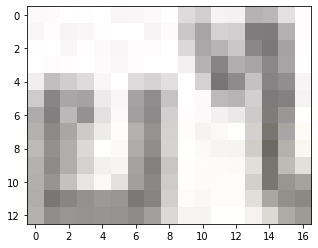

1 ้ 181 154 9 12


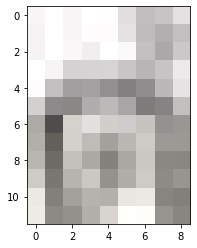

1 จ 0 0 998 601


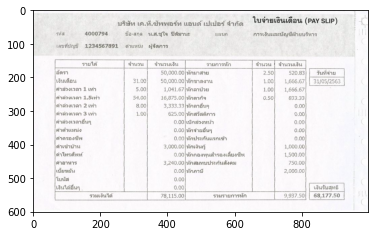

1 ํ 284 153 8 13


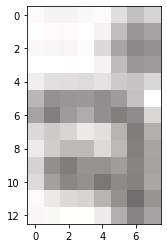

1 า 293 158 7 9


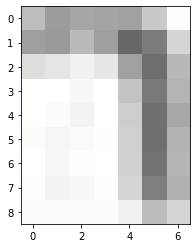

1 น 301 158 10 9


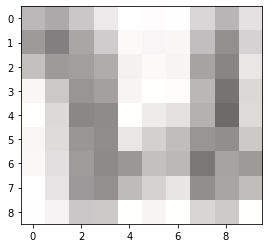

1 ว 312 158 6 9


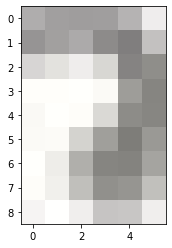

1 น 319 158 10 9


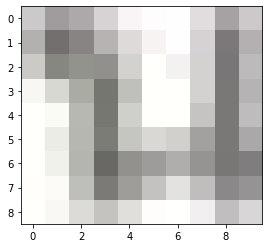

1 [ 0 0 998 601


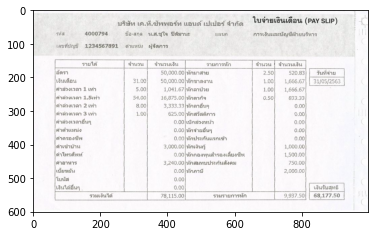

1 จ 0 0 998 601


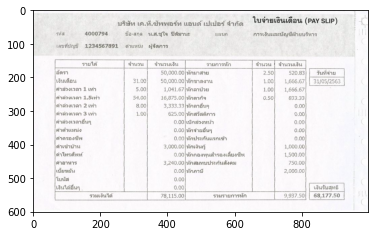

1 ํ 362 154 9 13


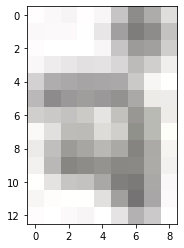

1 า 371 158 7 9


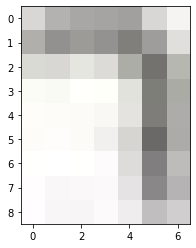

1 น 379 158 10 9


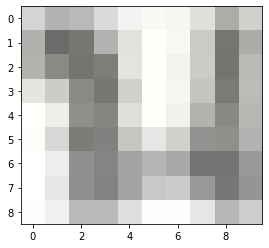

1 ว 390 158 7 9


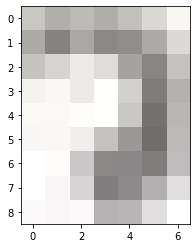

1 น 0 0 998 601


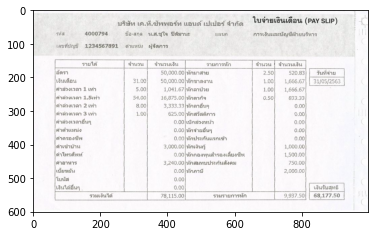

2 เง 398 158 16 9


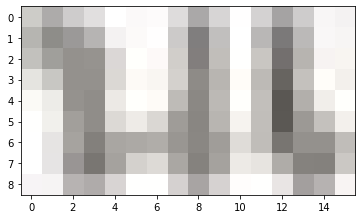

1 ิ 415 154 7 13


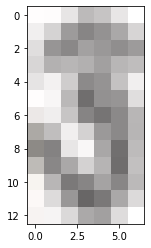

1 น 423 158 10 9


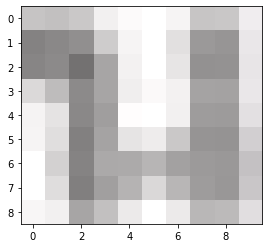

1 ร 0 0 998 601


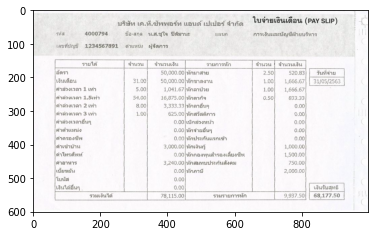

1 า 517 158 15 9


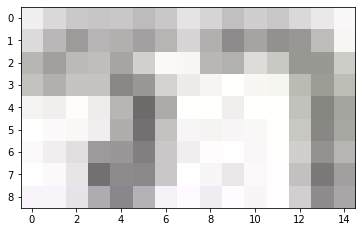

1 ย 533 158 9 9


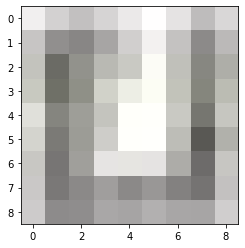

1 ก 0 0 998 601


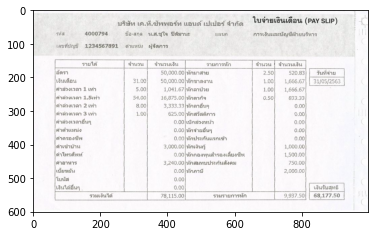

1 า 543 158 9 9


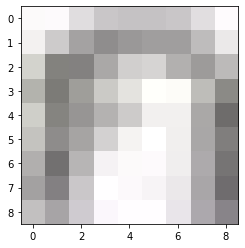

1 ร 554 158 6 9


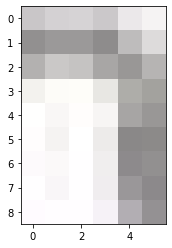

1 ห 0 0 998 601


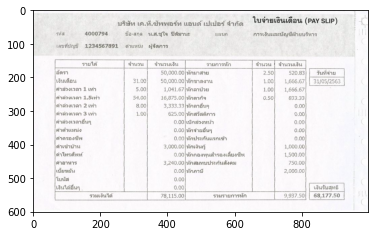

1 ั 561 154 21 13


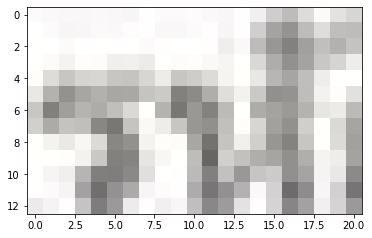

1 ก 581 159 9 8


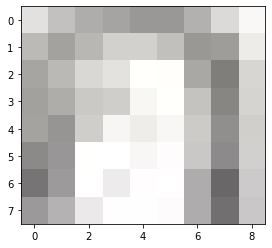

1 ล 664 154 9 13


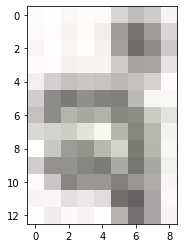

1 ํ 0 0 998 601


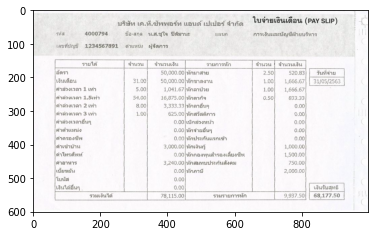

1 า 673 158 7 9


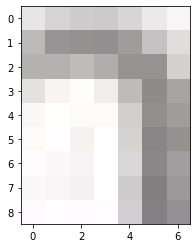

1 น 681 159 10 9


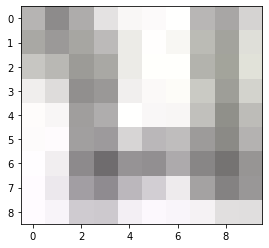

1 ว 692 159 7 8


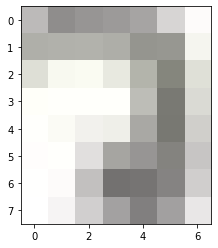

1 น 700 159 10 9


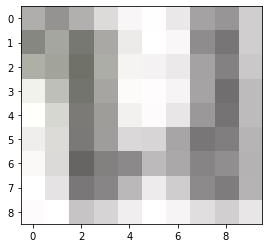

1 [ 0 0 998 601


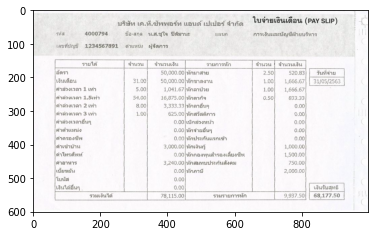

1 จ 0 0 998 601


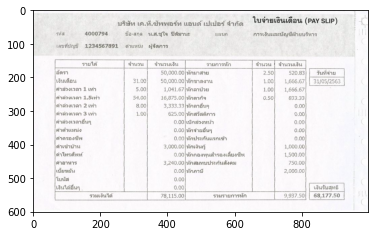

1 ํ 732 155 8 13


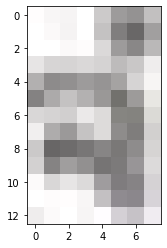

1 า 741 159 7 9


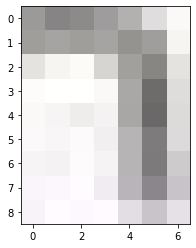

1 น 749 159 9 9


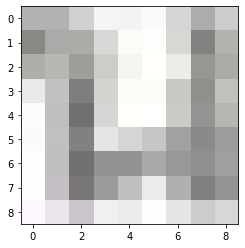

1 ว 759 159 7 9


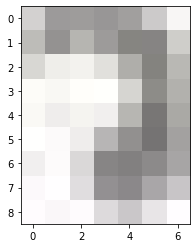

1 น 0 0 998 601


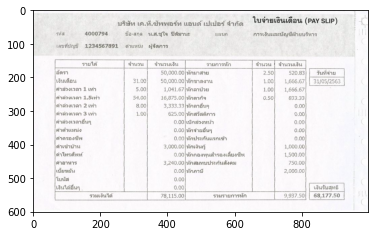

2 เง 767 159 15 9


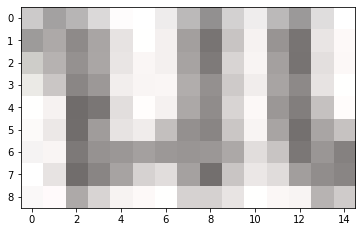

1 ิ 783 155 8 13


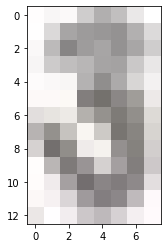

1 น 791 159 11 9


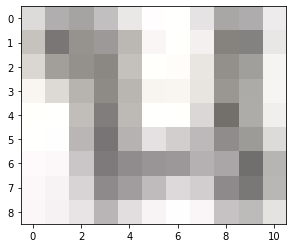

1 อ 0 0 998 601


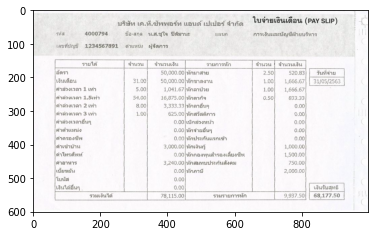

1 ั 70 178 10 14


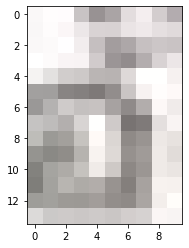

1 ต 80 182 9 10


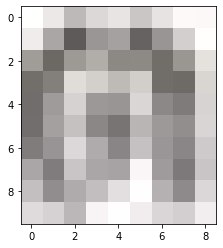

1 ร 89 182 8 10


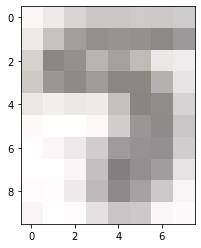

1 า 98 182 6 10


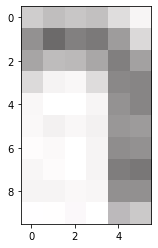

10 50,000.00| 381 180 70 15


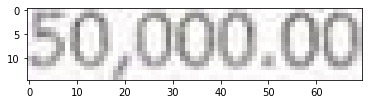

1 ห 457 179 10 14


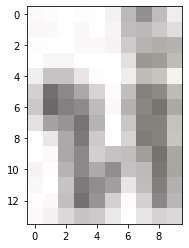

1 ั 0 0 998 601


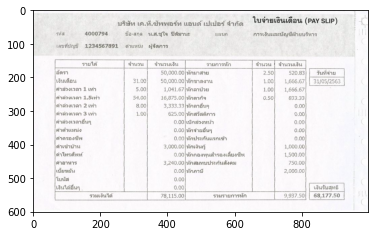

1 ค 468 179 19 14


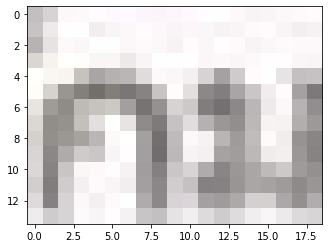

1 ม 0 0 998 601


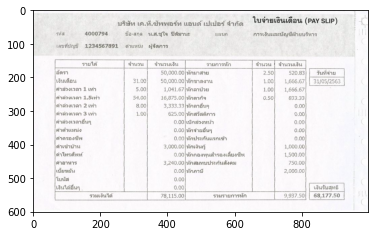

1 า 489 183 7 9


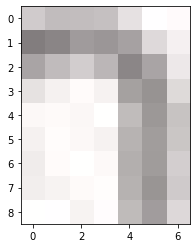

1 ส 0 0 998 601


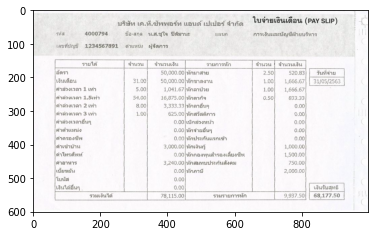

1 า 497 182 17 11


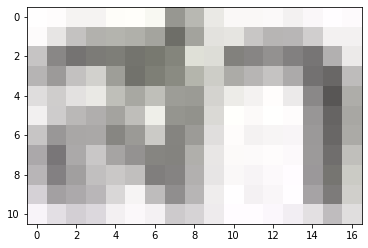

1 ย 515 183 9 10


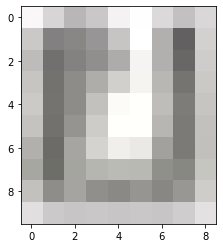

5 2.50| 687 181 30 12


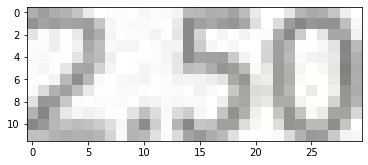

7 520.83| 763 181 46 12


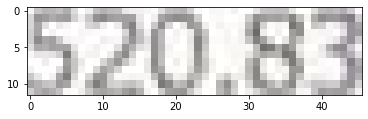

1 | 0 0 998 601


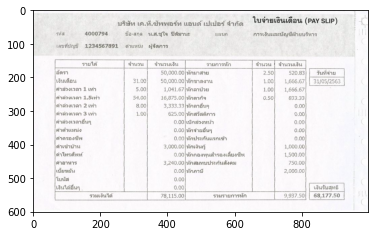

1 ว 0 0 998 601


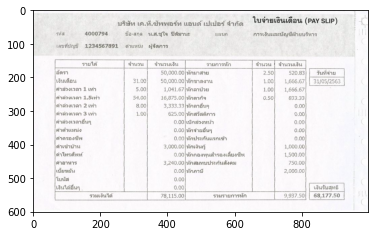

1 ั 0 0 998 601


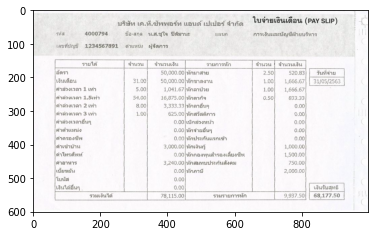

1 น 845 179 9 14


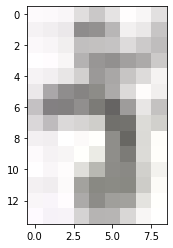

1 ท 853 184 11 9


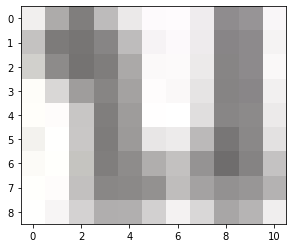

1 ี 0 0 998 601


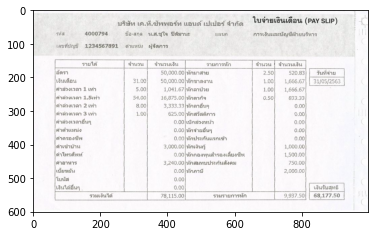

1 ่ 864 177 10 16


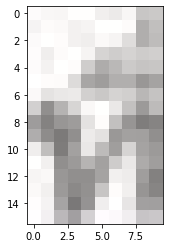

1 จ 876 180 7 13


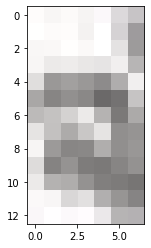

1 ่ 0 0 998 601


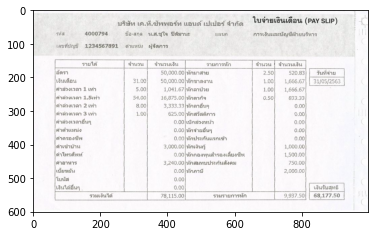

1 า 884 184 7 9


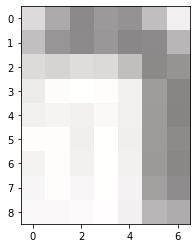

1 ย 893 184 8 9


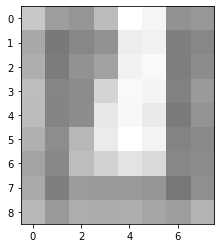

2 เง 69 204 13 13


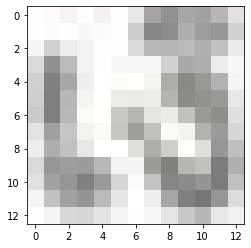

1 ิ 0 0 998 601


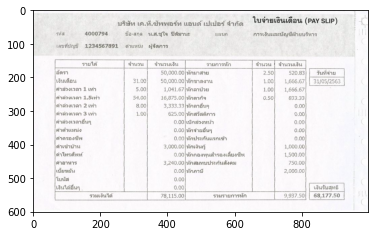

1 น 82 207 11 10


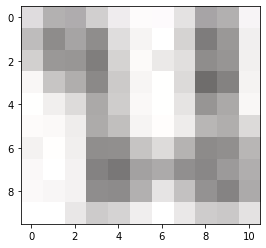

2 เด 94 203 15 14


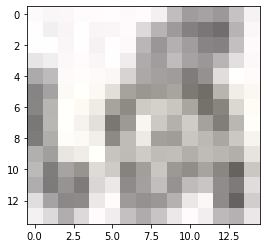

1 ื 109 207 9 10


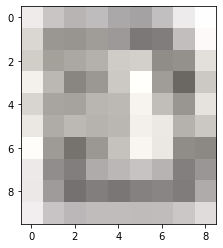

1 อ 0 0 998 601


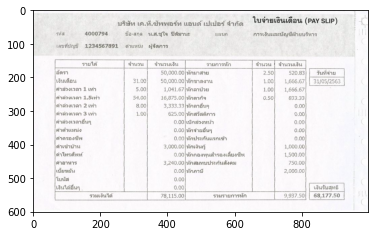

1 น 119 207 11 10


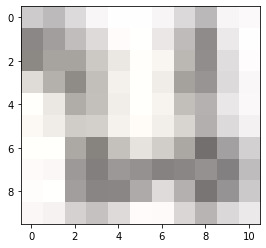

6 31.00| 299 205 38 12


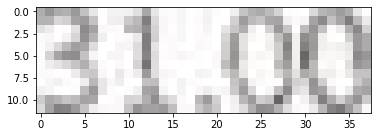

10 50,000.00| 381 205 69 14


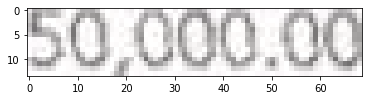

1 ห 457 204 12 14


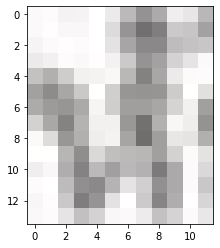

1 ั 0 0 998 601


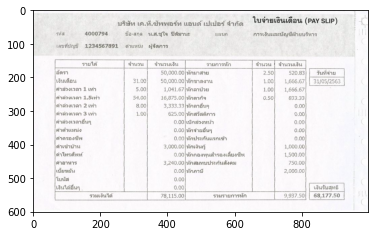

1 ก 468 208 10 10


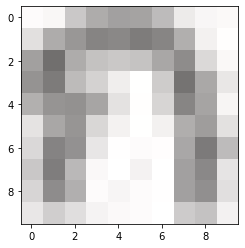

2 ขา 478 208 18 10


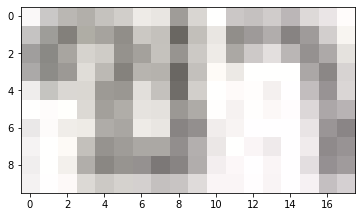

1 ด 497 208 10 10


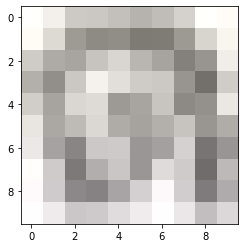

1 ง 508 208 8 10


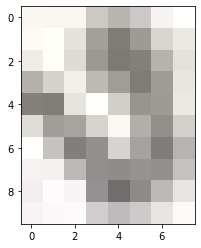

1 า 516 208 8 9


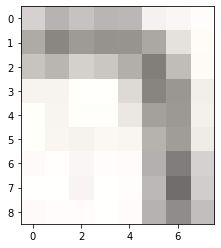

1 น 524 208 11 10


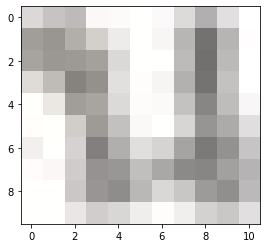

5 1.00| 688 206 28 12


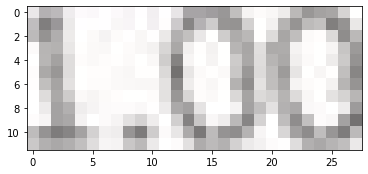

8 1666.67| 751 206 58 14


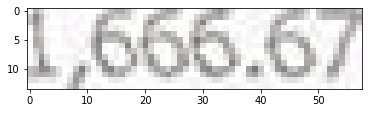

1 | 0 0 998 601


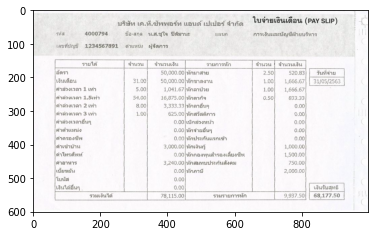

1 3 836 206 8 12


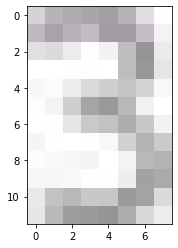

1 บ 847 206 11 15


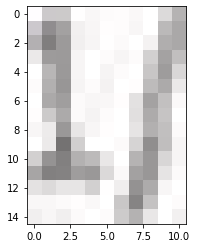

7 05/2563 859 205 57 16


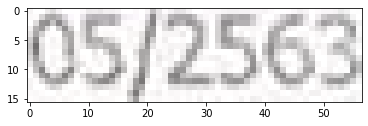

1 ค 0 0 998 601


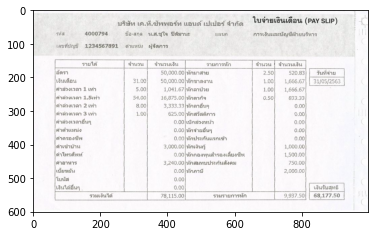

1 ํ 69 229 9 12


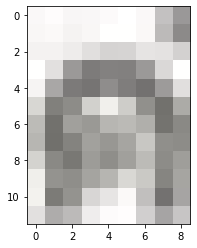

1 า 79 232 7 9


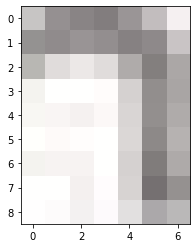

1 ล 0 0 998 601


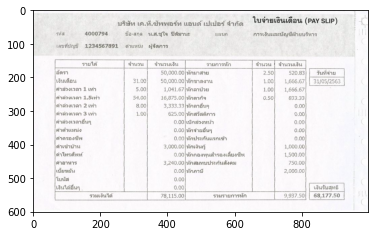

1 ่ 88 229 8 12


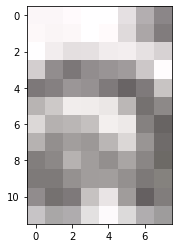

1 ว 97 232 7 9


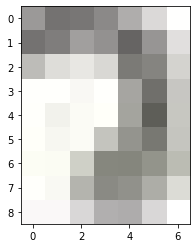

1 ง 105 232 7 9


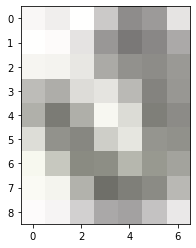

2 เว 114 232 12 9


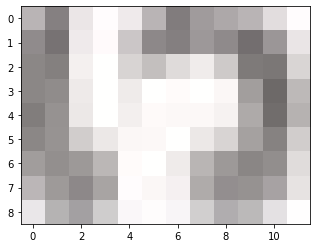

1 ล 0 0 998 601


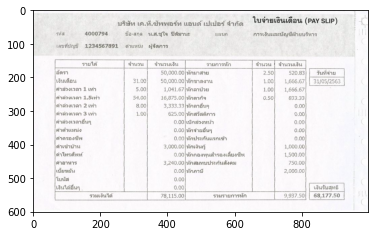

1 า 127 232 17 9


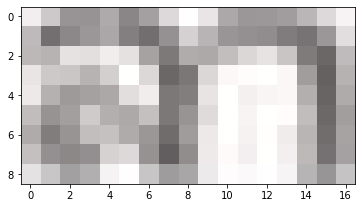

1 1 0 0 998 601


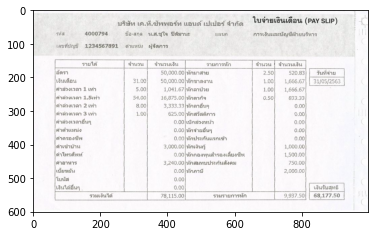

2 เท 151 229 18 12


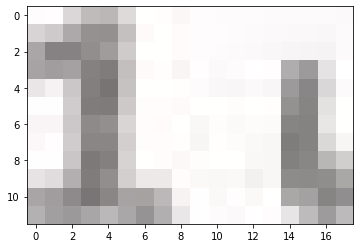

1 ่ 169 229 11 12


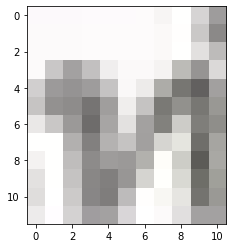

1 า 181 232 7 10


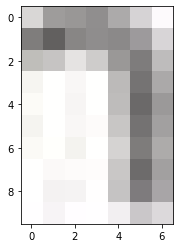

4 5.00 308 230 29 12


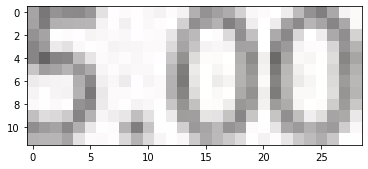

9 1.041.67| 391 230 59 14


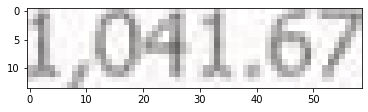

1 ห 0 0 998 601


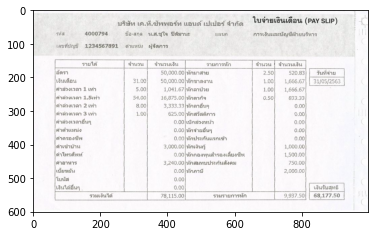

1 ั 457 229 12 13


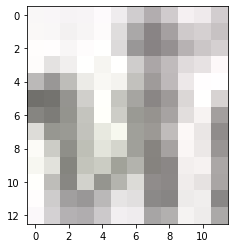

1 ค 468 233 9 9


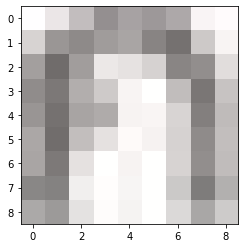

1 ล 0 0 998 601


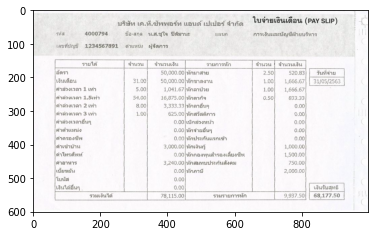

1 า 478 233 17 9


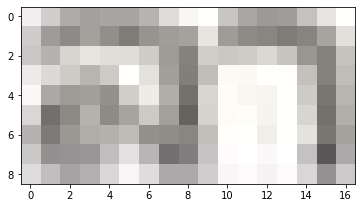

1 ป 0 0 998 601


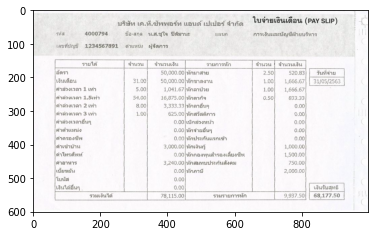

1 ่ 496 229 10 13


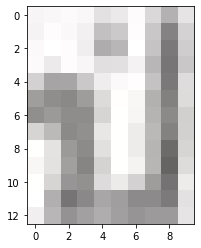

1 ว 507 233 7 9


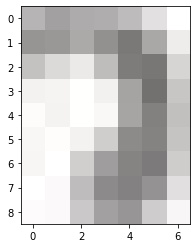

1 ย 515 233 9 9


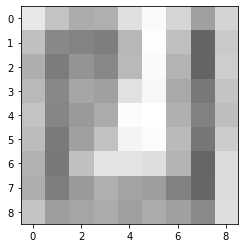

5 1.00| 688 231 28 12


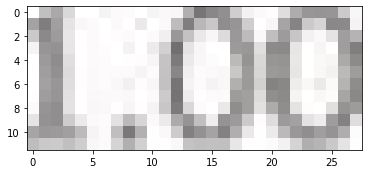

8 1,666.67 751 231 58 14


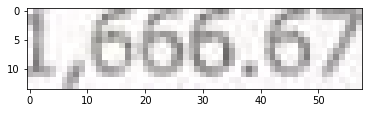

1 ค 0 0 998 601


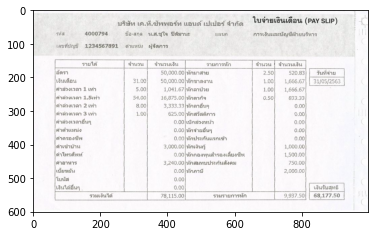

1 ่ 69 254 10 12


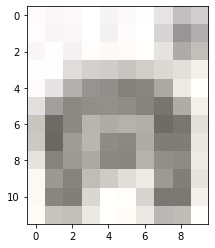

1 า 80 258 6 8


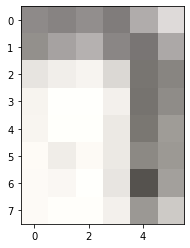

1 ล 0 0 998 601


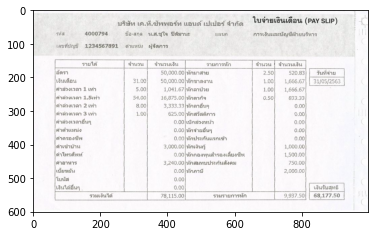

1 ่ 88 254 16 12


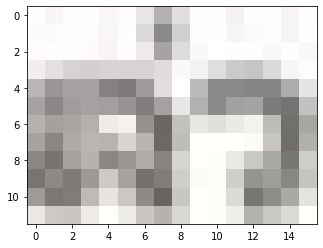

1 ว 0 0 998 601


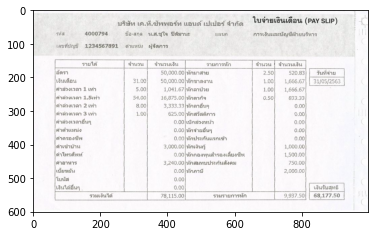

1 ง 105 257 8 9


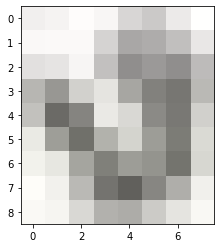

2 เว 114 258 12 8


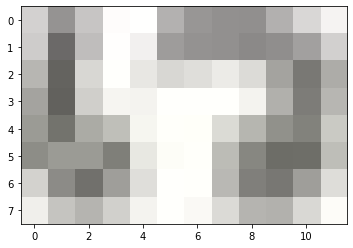

1 ล 0 0 998 601


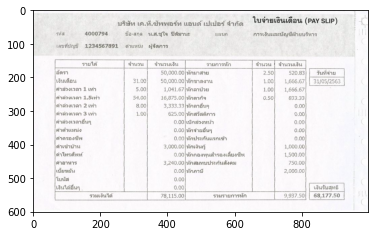

1 า 127 258 17 8


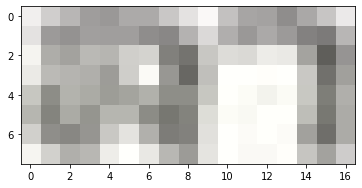

3 1.5 151 255 13 11


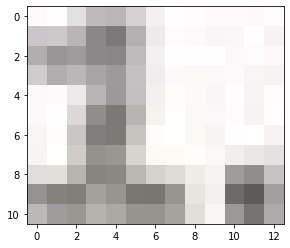

1 เ 165 255 14 11


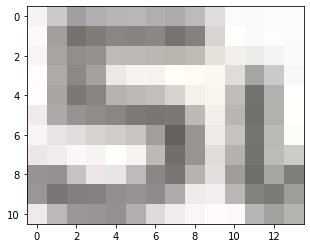

1 ท 0 0 998 601


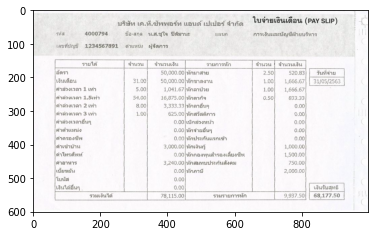

1 ่ 180 255 11 11


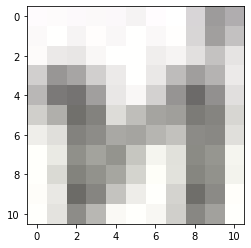

1 า 192 258 6 8


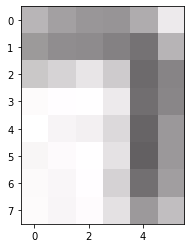

6 54.00| 299 255 38 12


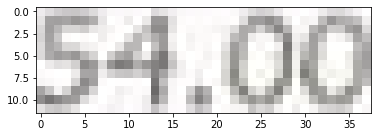

10 16,875.00| 382 256 68 14


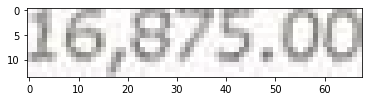

1 ห 457 255 13 12


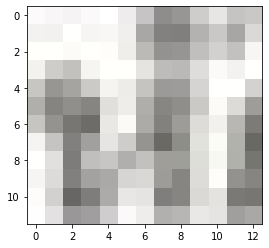

1 ั 0 0 998 601


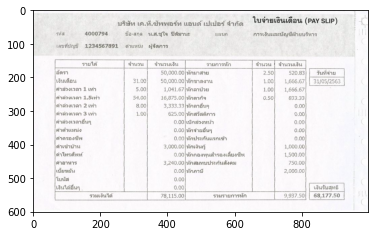

1 ก 468 259 9 8


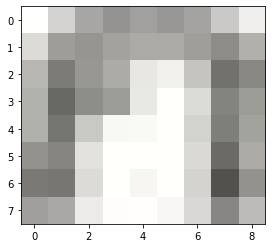

1 ล 0 0 998 601


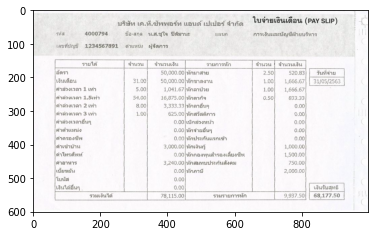

1 า 478 259 17 8


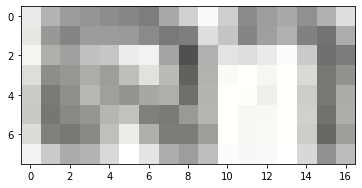

1 ก 0 0 998 601


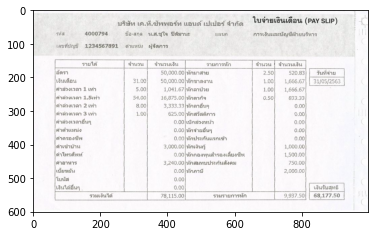

1 ิ 496 255 10 12


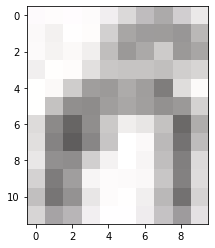

1 จ 508 259 7 8


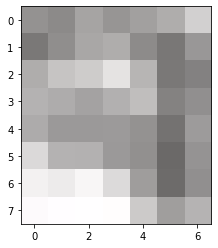

6 0.50|( 686 256 30 12


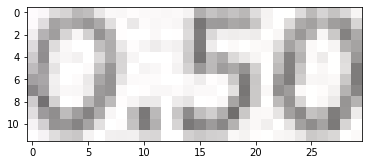

6 833.33 762 256 47 12


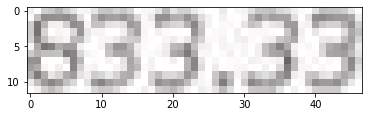

1 ค 0 0 998 601


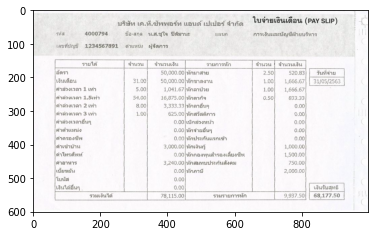

1 ่ 69 278 10 12


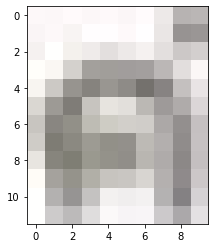

1 า 80 281 6 9


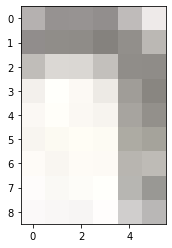

1 ล 0 0 998 601


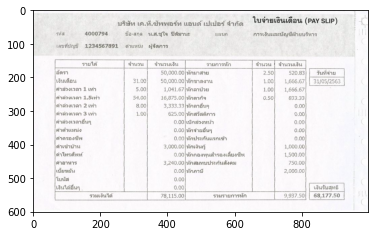

1 ่ 88 278 16 12


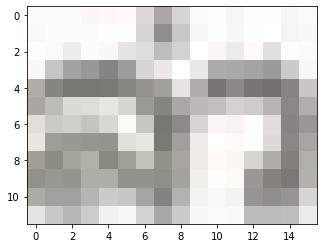

1 ว 0 0 998 601


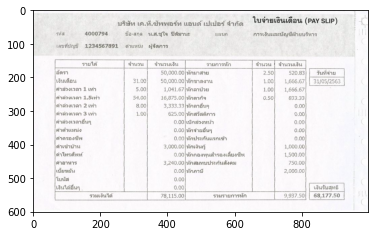

1 ง 106 281 7 9


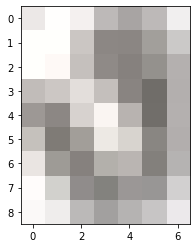

2 เว 114 281 12 9


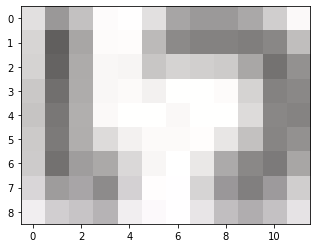

1 ล 128 281 9 9


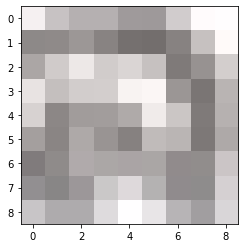

1 า 137 281 7 9


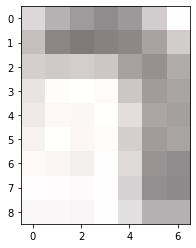

1 2 151 278 9 12


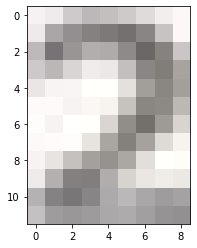

2 เท 165 278 16 12


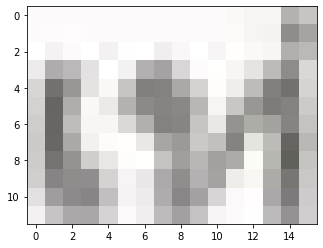

1 ่ 0 0 998 601


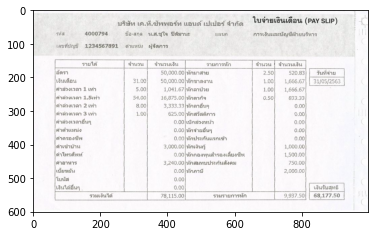

1 า 182 281 7 9


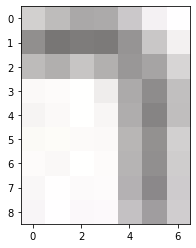

4 8.00 308 279 29 12


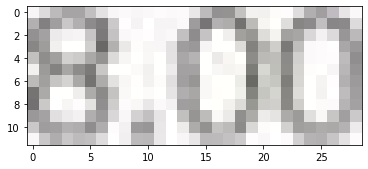

9 3,333.33| 390 279 60 14


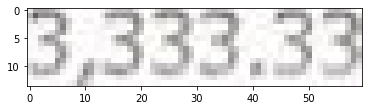

1 ห 0 0 998 601


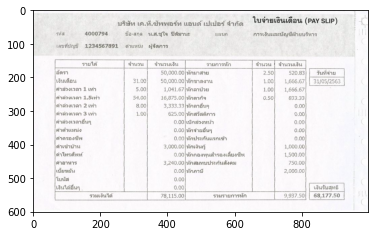

1 ั 457 278 13 13


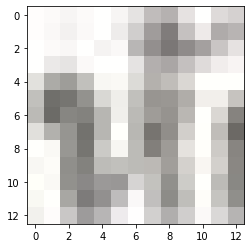

1 ค 468 282 10 9


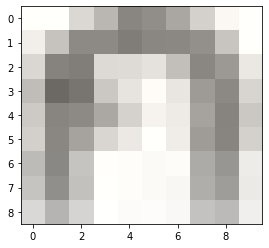

1 ล 0 0 998 601


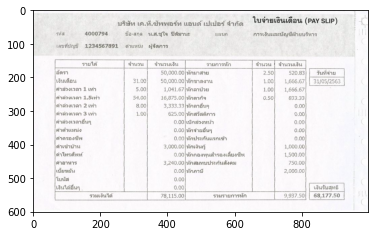

1 า 479 282 17 9


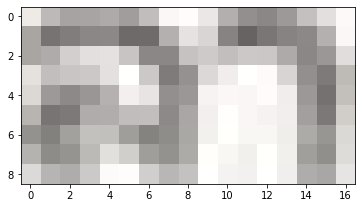

1 อ 0 0 998 601


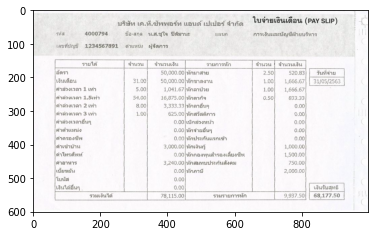

1 ื 497 276 8 15


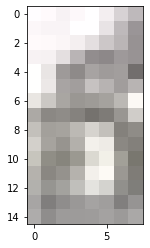

1 ่ 0 0 998 601


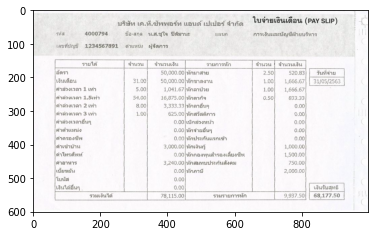

1 น 507 282 10 9


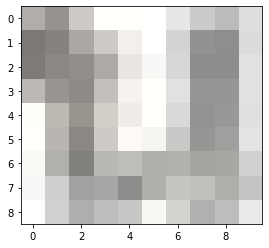

1 ๆ 517 282 7 12


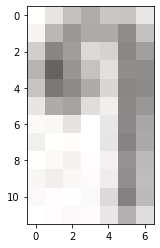

5 0.00| 780 280 30 12


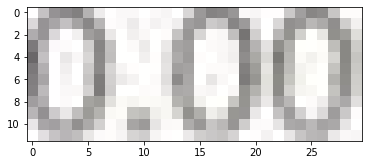

1 ค 0 0 998 601


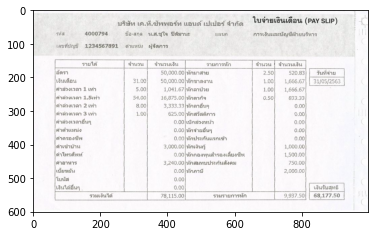

1 ่ 0 0 998 601


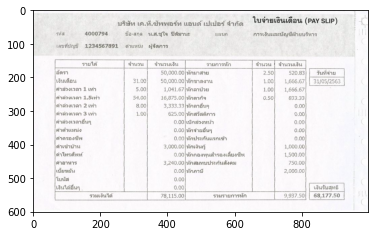

1 า 70 302 17 12


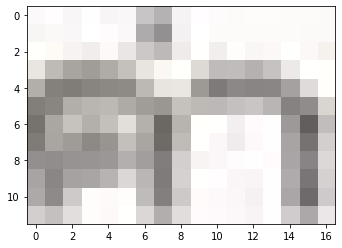

1 ส 0 0 998 601


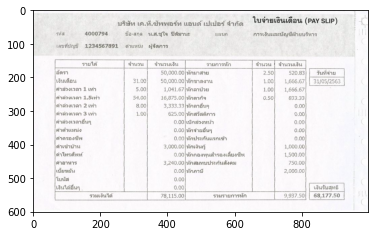

1 ่ 88 302 16 12


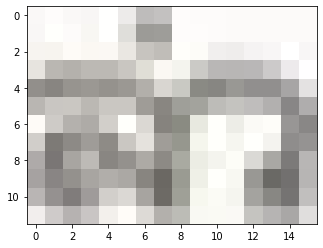

1 ว 0 0 998 601


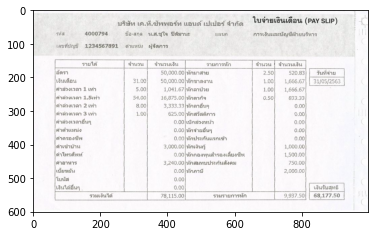

1 ง 105 305 8 9


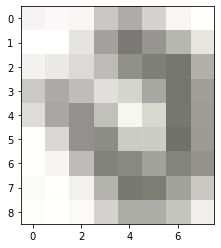

2 เว 114 305 12 9


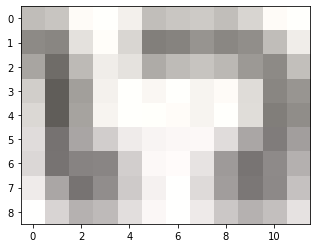

1 ล 0 0 998 601


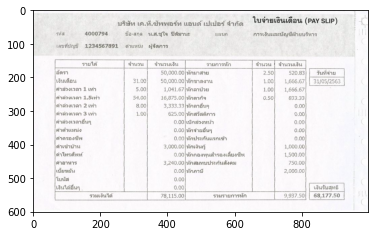

1 า 127 305 18 9


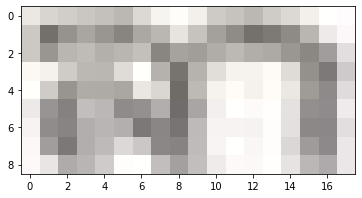

1 3 150 303 10 11


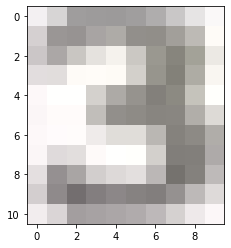

2 เท 165 305 5 9


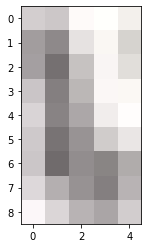

1 ่ 170 302 11 12


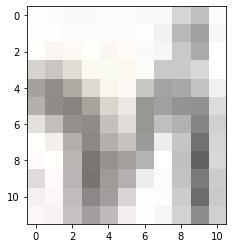

1 า 181 305 8 9


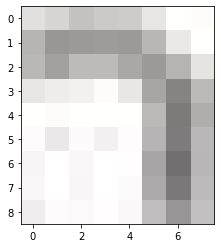

4 1.00 309 303 28 12


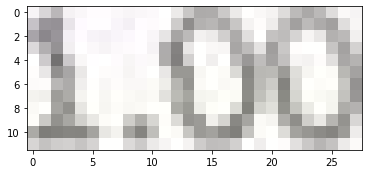

7 625.00| 404 303 47 12


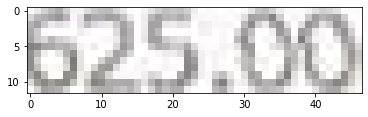

1 ห 457 302 10 13


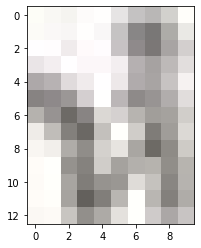

1 ั 0 0 998 601


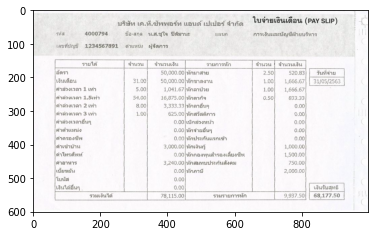

1 ก 467 302 11 13


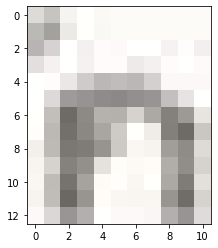

1 ส 0 0 998 601


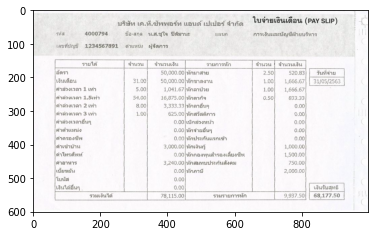

1 ว 479 302 18 13


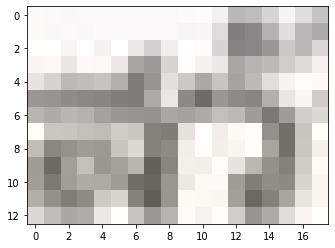

1 ั 0 0 998 601


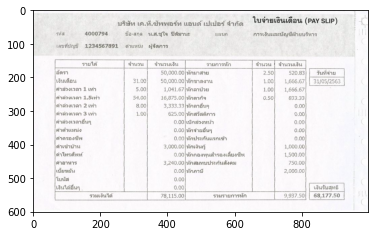

1 ส 497 305 9 10


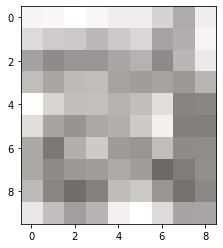

1 ด 0 0 998 601


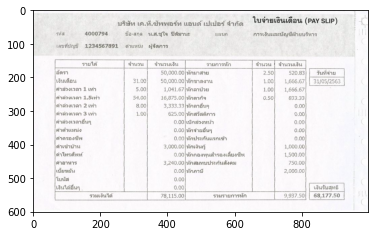

1 ิ 507 303 9 12


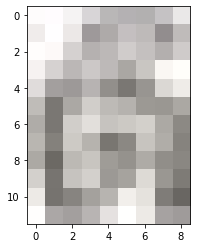

1 ก 0 0 998 601


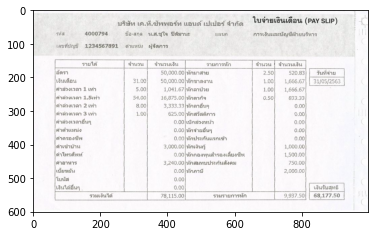

1 า 518 306 17 9


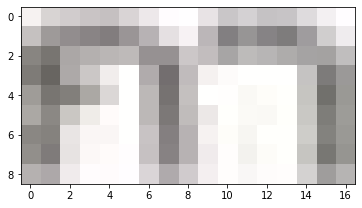

1 ร 536 306 7 9


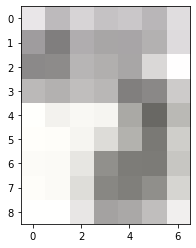

5 0.00| 779 304 31 12


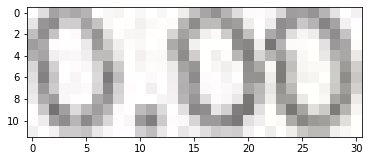

1 ค 0 0 998 601


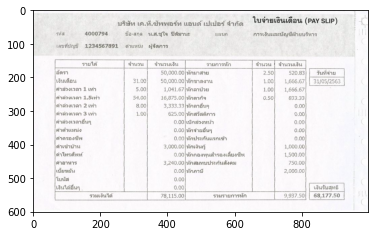

1 ํ 69 326 9 12


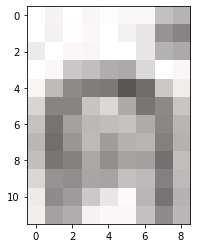

1 า 79 329 7 9


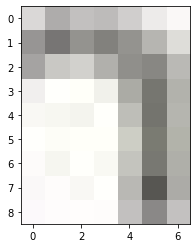

1 ล 0 0 998 601


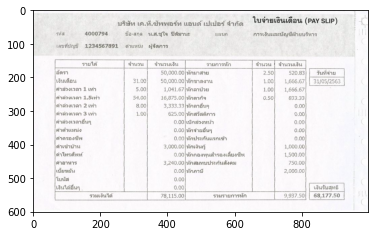

1 ่ 87 326 16 12


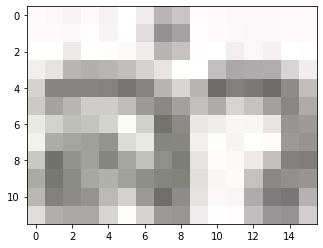

1 ว 0 0 998 601


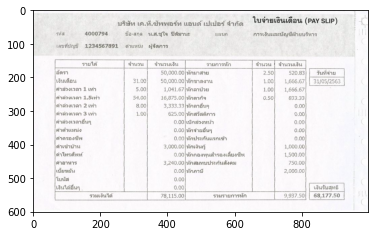

1 ง 105 329 7 9


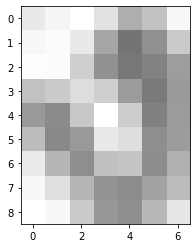

2 เว 114 329 12 9


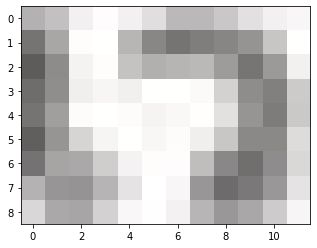

1 ล 0 0 998 601


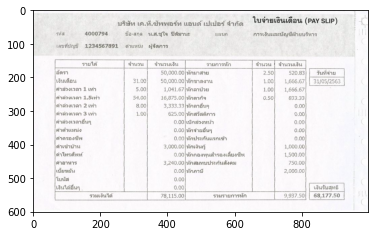

1 า 127 329 17 9


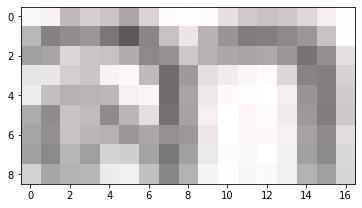

1 อ 0 0 998 601


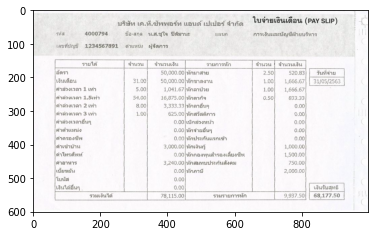

1 ื 145 323 9 15


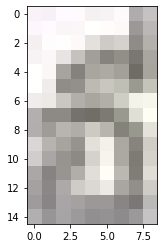

1 ่ 0 0 998 601


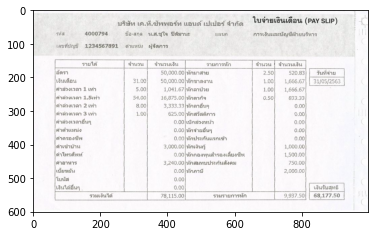

1 น 155 329 19 13


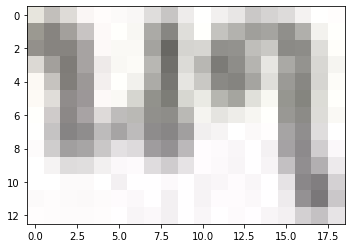

5 0.00| 420 328 30 12


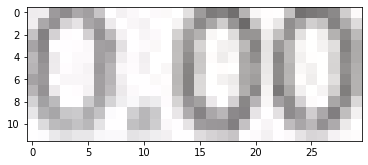

1 เ 457 330 4 9


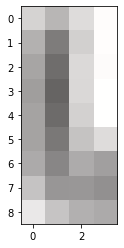

1 บ 0 0 998 601


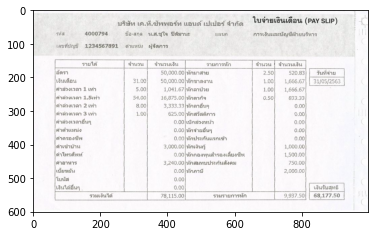

1 ิ 462 327 10 12


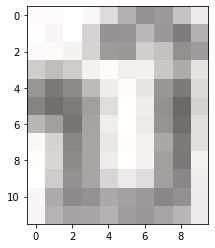

1 ค 473 330 9 9


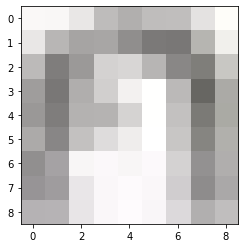

1 ล 0 0 998 601


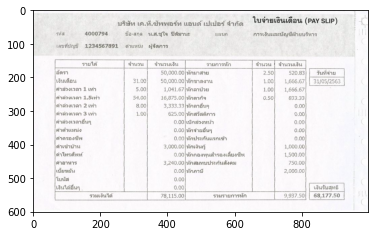

1 ่ 483 327 17 12


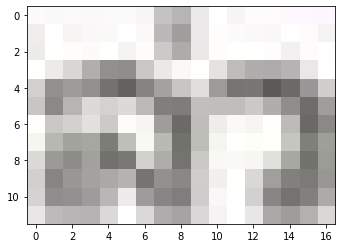

1 ว 0 0 998 601


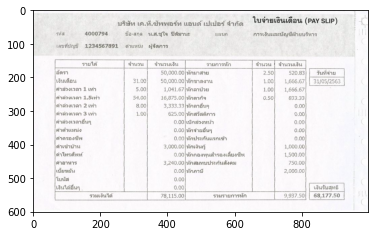

1 ง 501 330 8 9


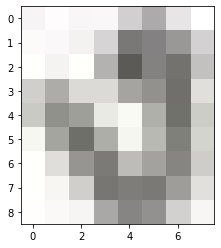

1 ห 510 330 9 9


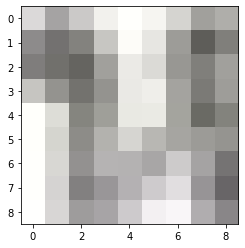

1 น 0 0 998 601


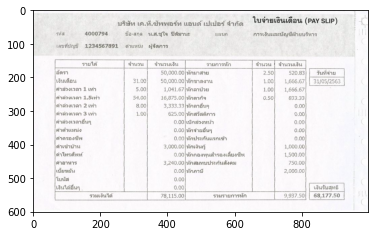

1 ้ 520 327 13 12


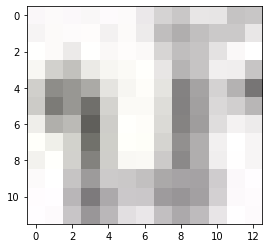

1 า 531 330 7 9


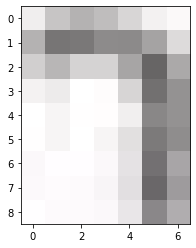

4 0.00 779 328 30 12


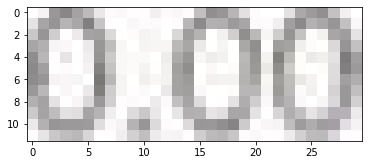

1 ค 0 0 998 601


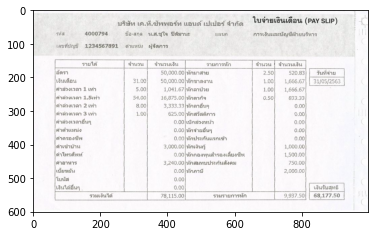

1 ํ 69 351 10 12


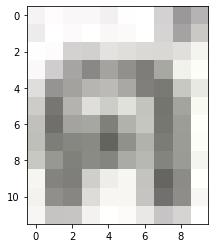

1 า 79 354 7 9


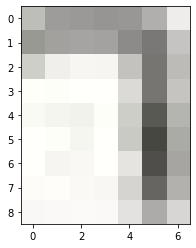

1 ต 0 0 998 601


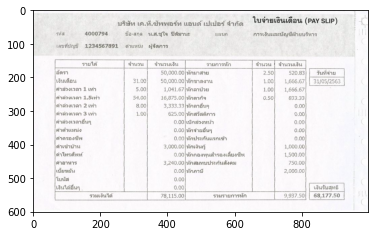

1 ํ 87 350 17 13


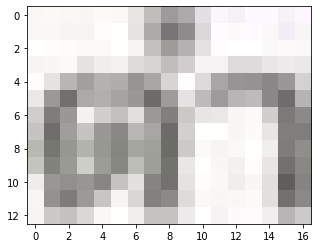

1 า 0 0 998 601


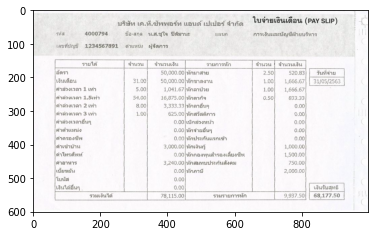

2 แห 106 354 19 9


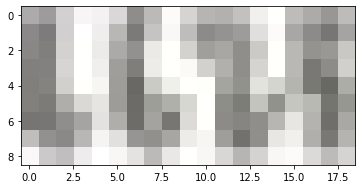

1 น 0 0 998 601


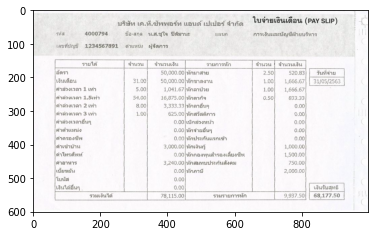

1 ่ 126 351 10 12


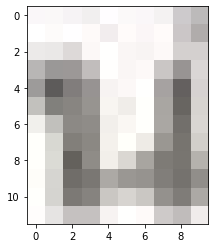

1 ง 137 354 7 9


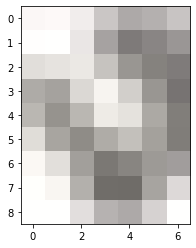

5 0.00| 420 352 30 12


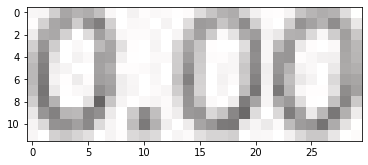

1 ห 0 0 998 601


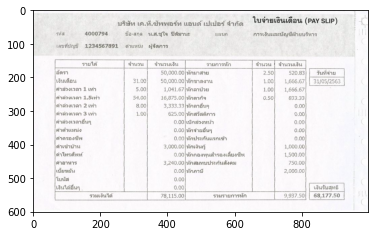

1 ั 457 351 10 13


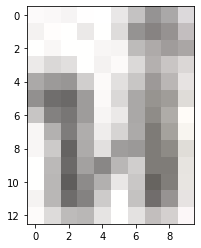

1 ค 468 351 9 13


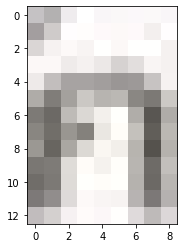

1 จ 0 0 998 601


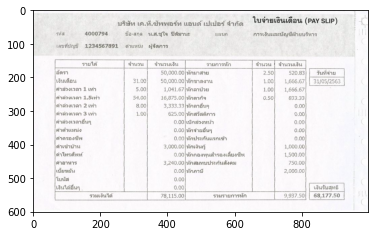

1 ่ 478 352 9 11


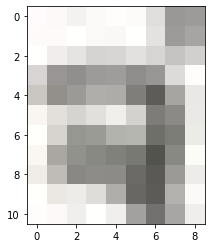

1 า 487 355 7 8


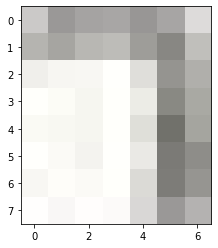

1 ย 495 355 9 9


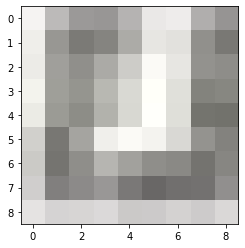

1 อ 0 0 998 601


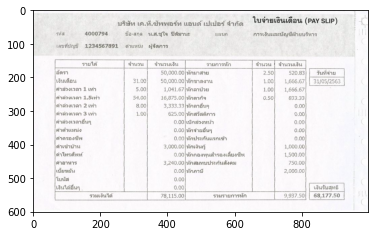

1 ื 506 348 9 16


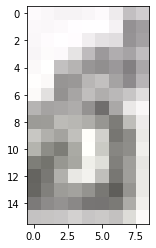

1 ่ 0 0 998 601


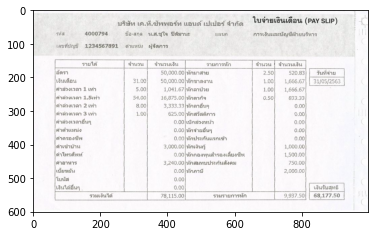

1 น 515 355 10 9


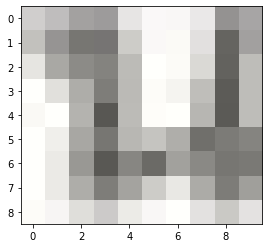

1 ๆ 526 355 7 12


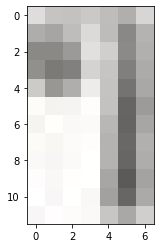

4 0.00 779 352 30 12


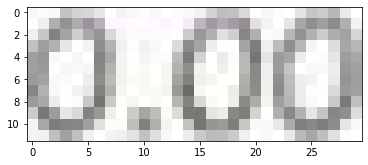

1 ค 69 375 10 12


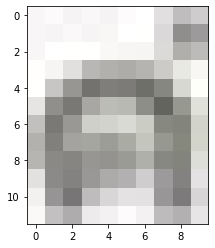

1 ่ 0 0 998 601


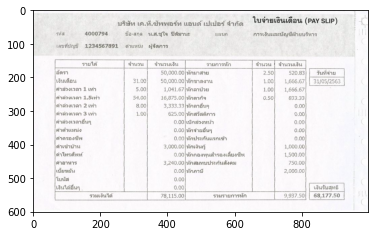

1 า 79 378 7 9


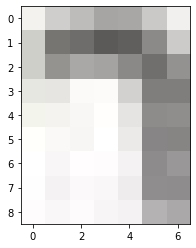

1 ค 88 378 9 9


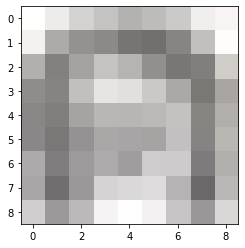

1 ร 0 0 998 601


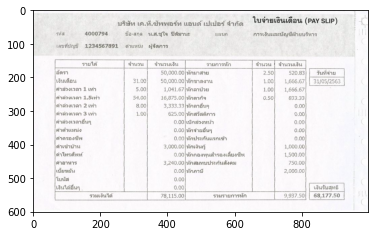

1 อ 98 378 17 9


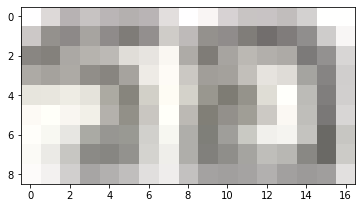

1 ง 0 0 998 601


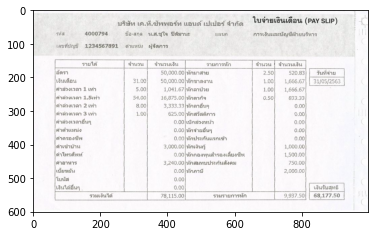

2 ซี 116 374 19 13


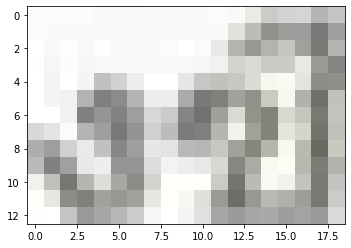

1 พ 136 378 11 9


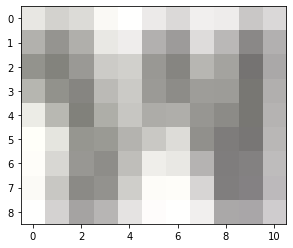

5 0.00| 421 376 30 12


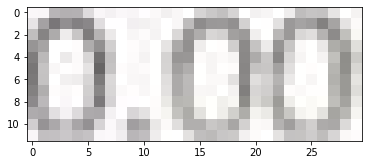

1 ห 0 0 998 601


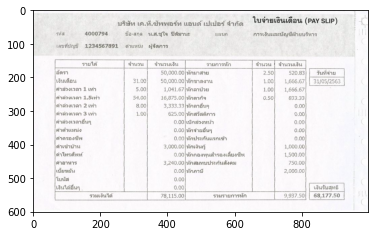

1 ั 457 375 13 13


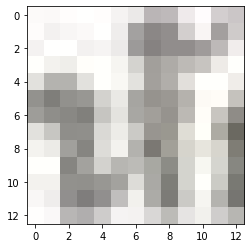

1 ก 468 379 9 9


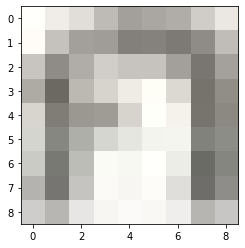

1 ป 478 375 10 13


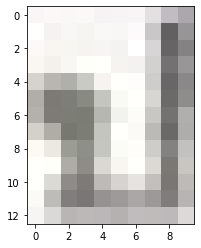

1 ร 0 0 998 601


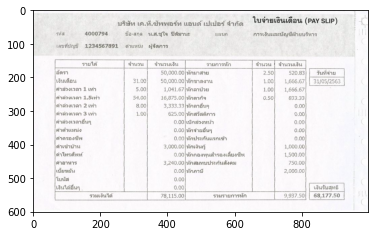

1 ะ 489 379 16 9


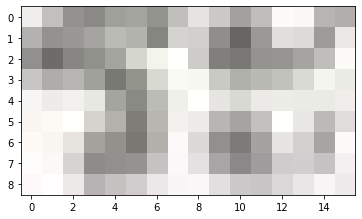

1 ค 0 0 998 601


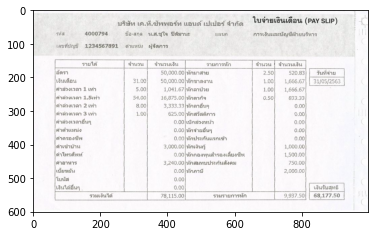

1 ั 505 375 11 13


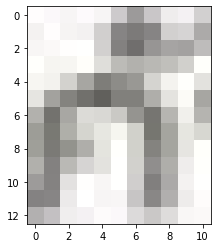

1 น 515 379 10 9


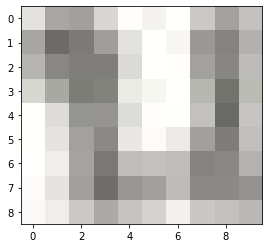

2 แร 526 379 10 9


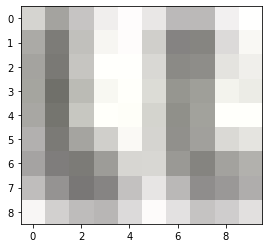

1 ก 536 379 7 9


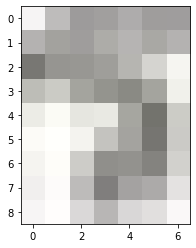

2 เข 544 379 15 9


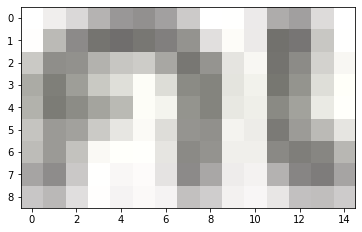

1 ้ 559 375 10 13


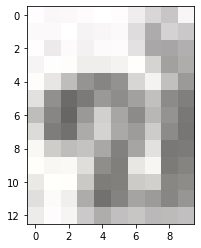

1 า 570 379 7 9


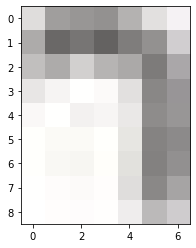

4 0.00 779 376 30 12


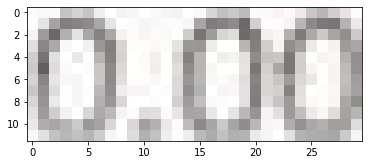

1 ค 0 0 998 601


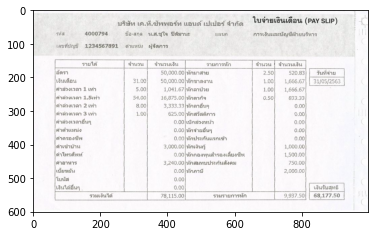

1 ่ 69 400 10 12


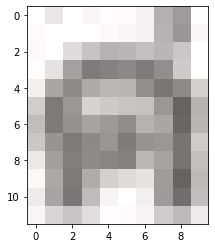

1 า 80 402 6 10


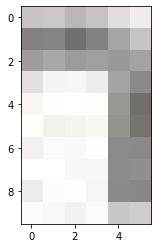

2 เข 88 399 15 13


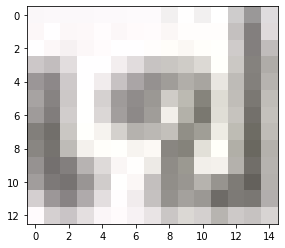

1 ่ 0 0 998 601


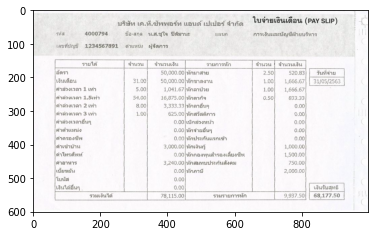

1 า 104 402 7 10


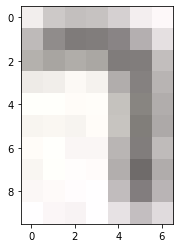

1 บ 112 399 9 13


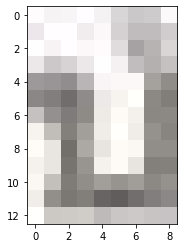

1 ้ 121 399 9 13


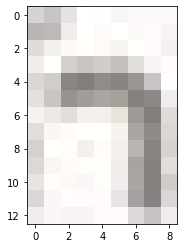

1 า 0 0 998 601


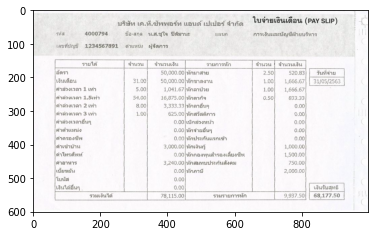

1 น 131 402 10 10


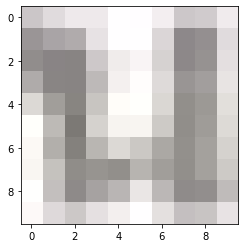

9 3,000.00| 390 400 60 14


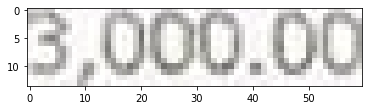

1 น 0 0 998 601


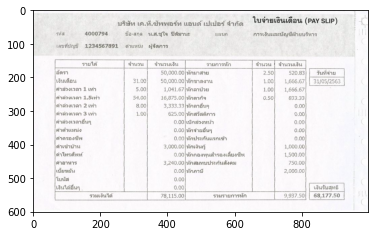

1 ั 457 400 10 12


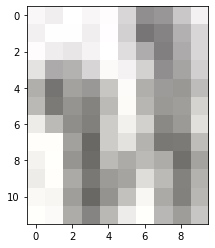

1 ก 0 0 998 601


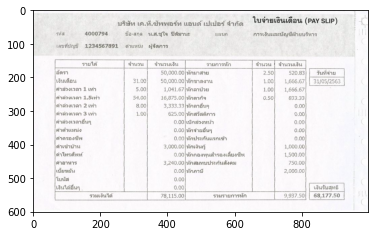

2 เง 468 403 15 9


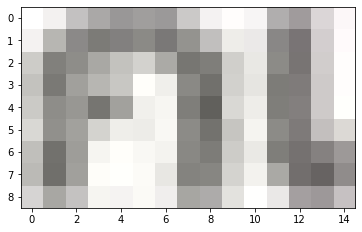

1 ิ 484 400 7 12


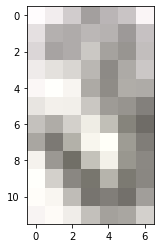

1 น 0 0 998 601


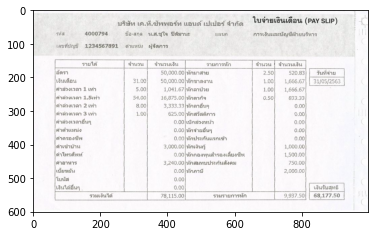

1 ค 493 403 10 9


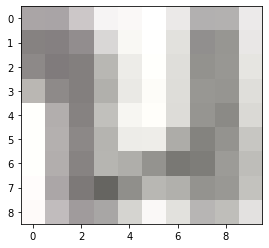

1 ู 0 0 998 601


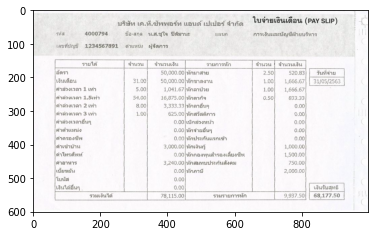

1 ้ 504 400 9 16


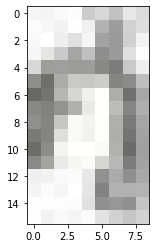

8 1,000.00 751 400 58 14


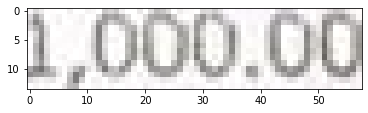

3 ด่า 69 424 18 12


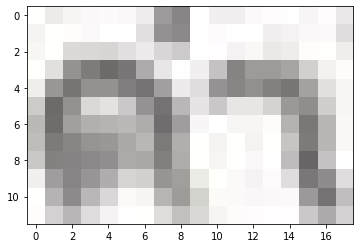

2 โท 87 423 18 13


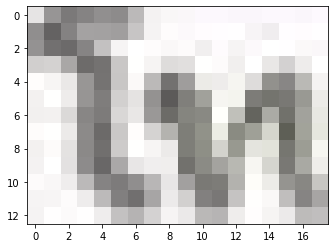

1 ร 105 427 8 9


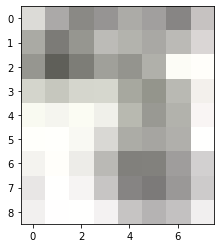

2 ศั 114 422 11 14


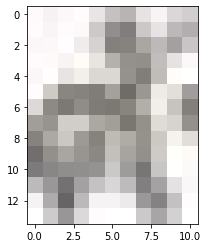

1 พ 123 427 13 9


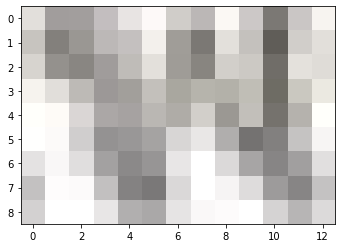

1 ท 0 0 998 601


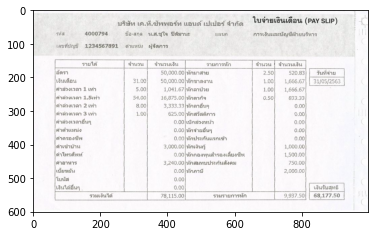

1 ์ 136 423 14 13


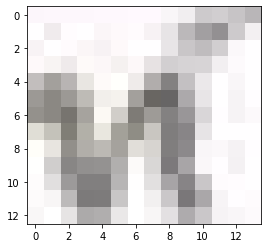

5 0.00( 420 425 30 11


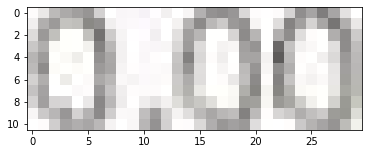

1 ห 456 423 13 13


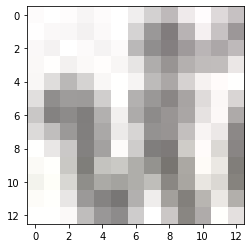

1 ั 0 0 998 601


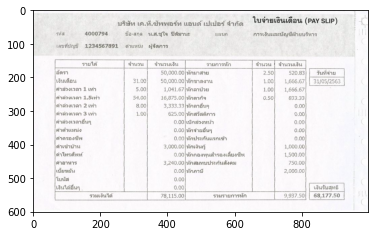

1 ค 468 427 9 9


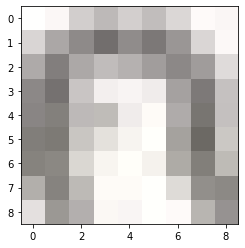

1 ค 478 427 10 9


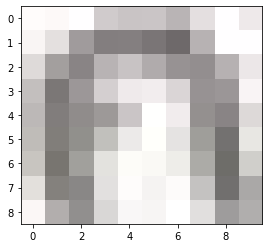

1 อ 489 427 9 9


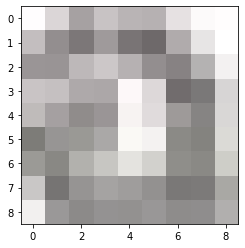

1 ง 499 427 7 9


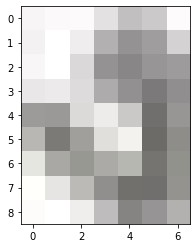

1 ท 0 0 998 601


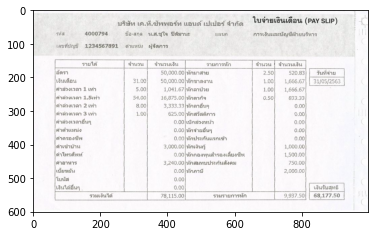

1 ุ 507 427 11 13


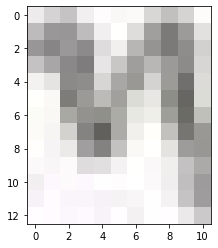

1 น 0 0 998 601


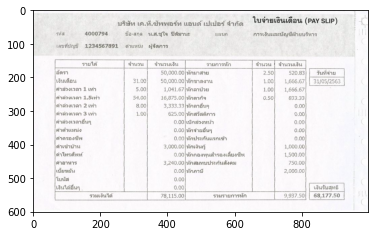

1 ส 518 423 29 13


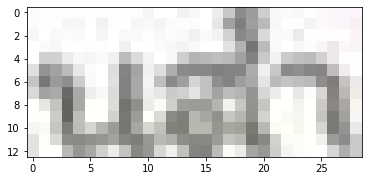

1 ํ 0 0 998 601


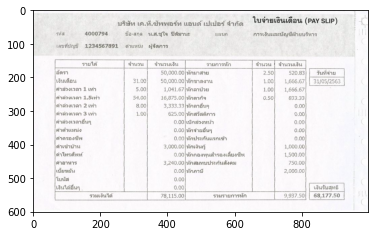

1 า 0 0 998 601


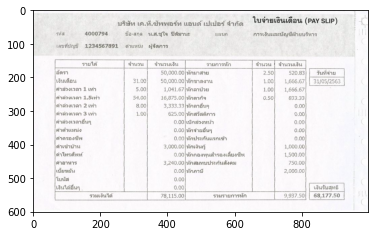

1 ร 547 427 7 9


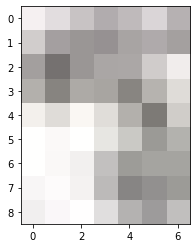

1 อ 0 0 998 601


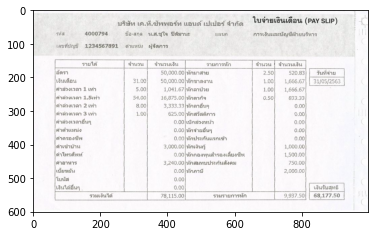

1 ง 556 427 9 9


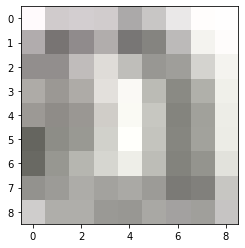

2 เล 565 427 14 9


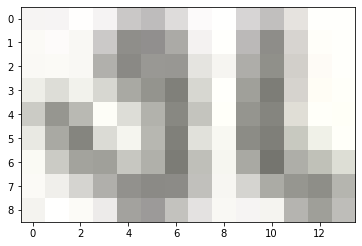

1 ี 580 421 9 15


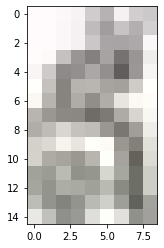

1 ้ 589 427 10 9


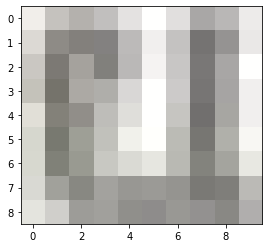

1 ย 0 0 998 601


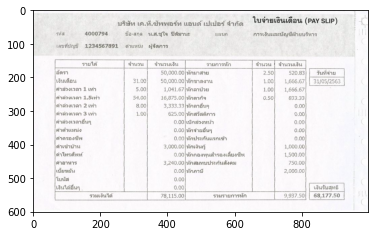

1 ง 600 427 7 9


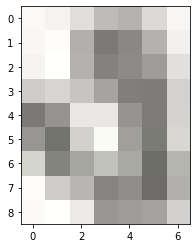

2 ซี 608 422 11 14


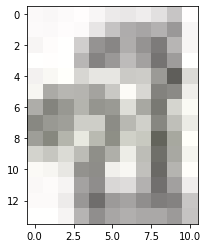

1 ห 619 427 12 9


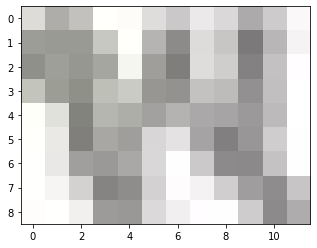

7 1500.00 750 424 59 15


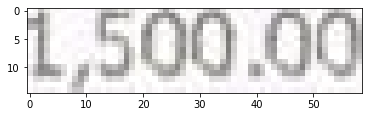

1 ค 0 0 998 601


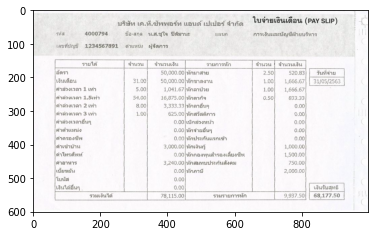

1 ํ 69 448 9 12


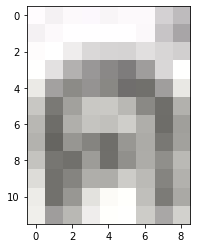

1 า 79 451 7 9


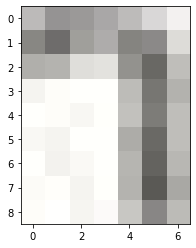

1 อ 87 451 9 9


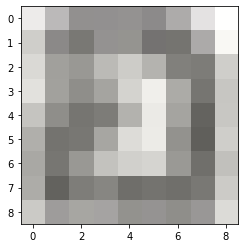

1 า 97 451 7 9


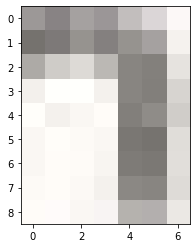

1 ห 104 451 10 9


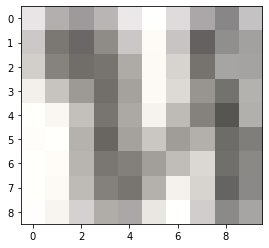

1 า 115 451 7 9


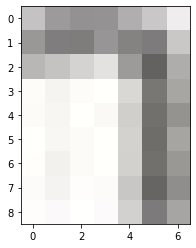

1 ร 123 451 8 9


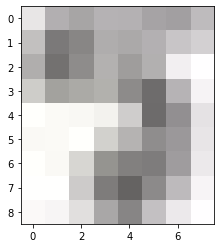

9 3,240.00| 389 449 61 14


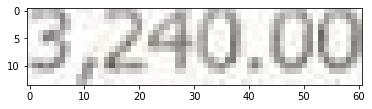

1 ห 457 448 10 13


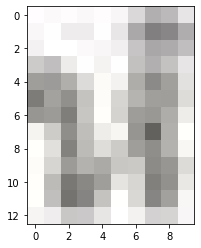

1 ั 0 0 998 601


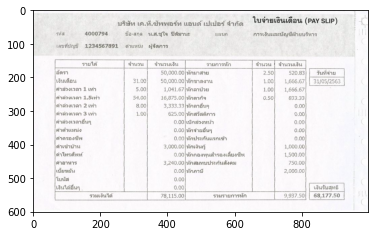

1 ก 468 448 9 13


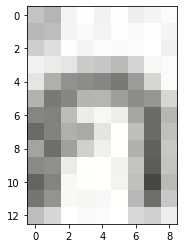

1 ส 478 450 19 11


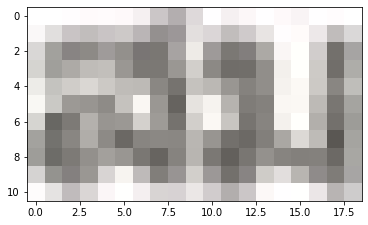

1 ม 0 0 998 601


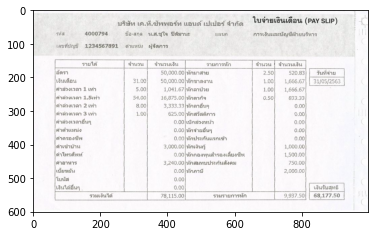

1 ท 498 451 10 10


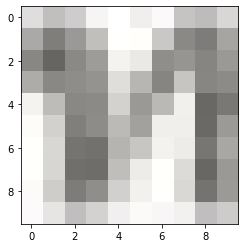

1 บ 0 0 998 601


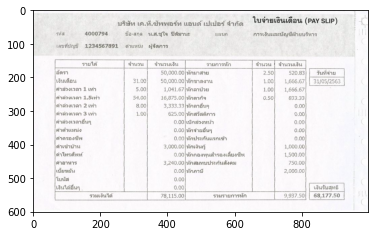

1 ป 509 451 10 10


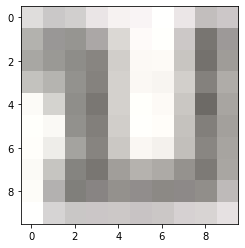

1 ร 520 448 10 13


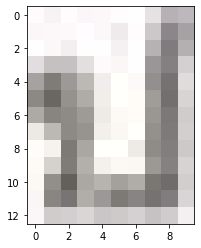

1 ะ 530 451 8 9


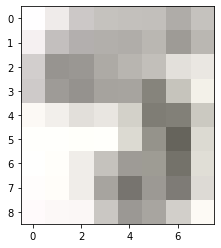

1 ก 0 0 998 601


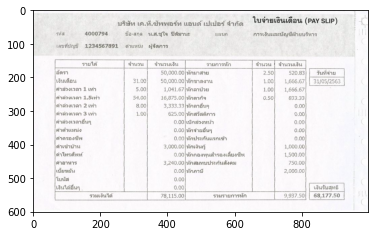

1 ั 539 448 17 13


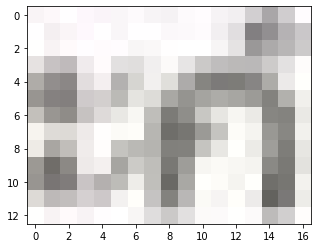

1 น 0 0 998 601


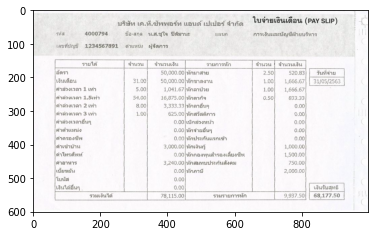

1 ส 0 0 998 601


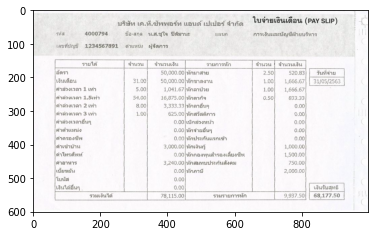

1 ั 556 447 29 14


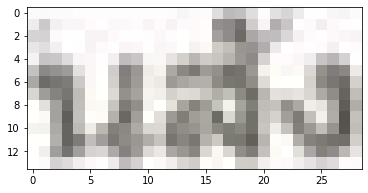

1 ง 0 0 998 601


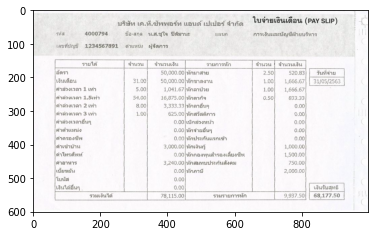

1 ค 586 451 9 10


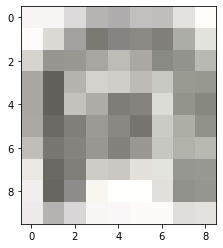

1 ม 596 451 9 9


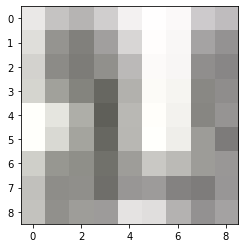

6 750.00 762 449 47 12


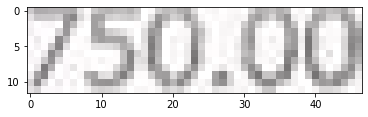

2 เบ 69 475 5 9


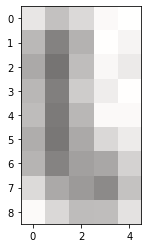

1 ี 74 469 10 15


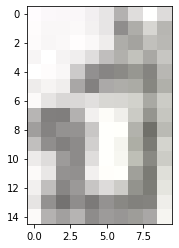

1 ้ 0 0 998 601


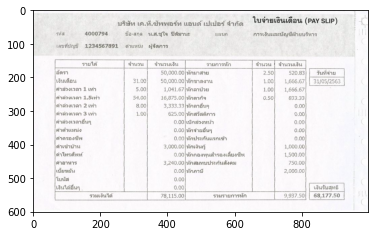

1 ย 85 475 9 9


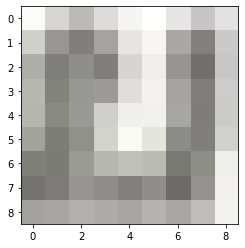

4 ขยัน 95 472 30 12


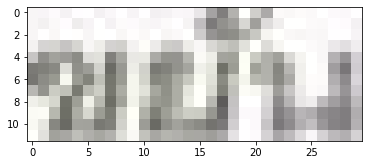

5 0.00| 421 473 29 12


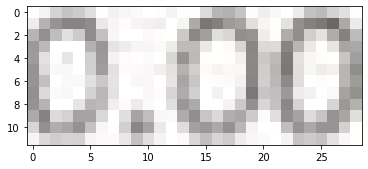

1 ห 0 0 998 601


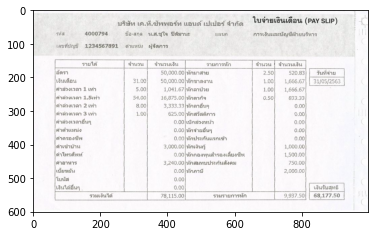

1 ั 457 472 13 13


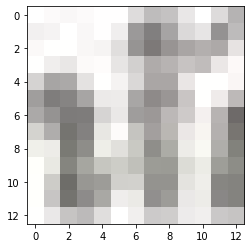

1 ก 468 476 9 9


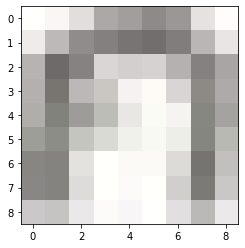

2 ภา 478 476 10 9


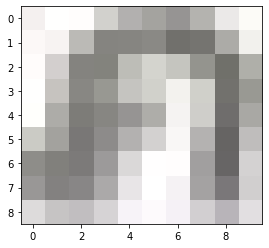

2 ษี 489 472 18 13


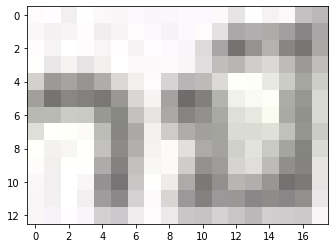

8 2,000.00 749 473 60 14


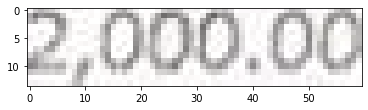

2 โบ 69 496 17 13


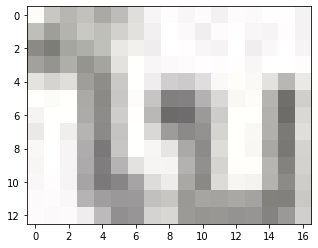

1 น 0 0 998 601


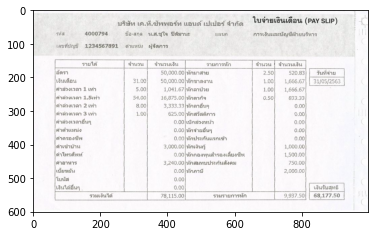

1 ั 87 496 11 13


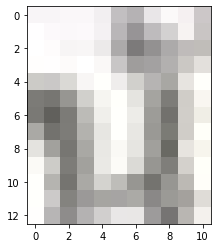

1 ส 98 499 9 10


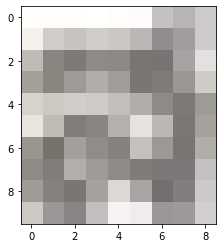

4 0.00 421 498 29 12


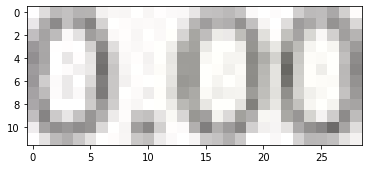

2 เง 69 523 5 11


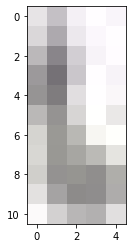

1 ิ 74 521 8 13


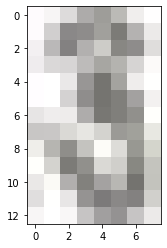

1 น 82 524 11 10


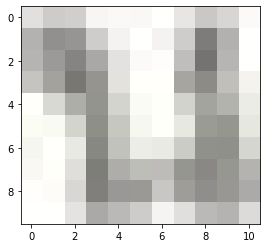

2 ได 92 521 9 13


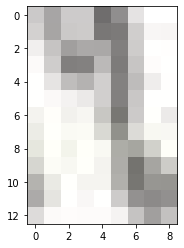

1 ้ 101 521 11 13


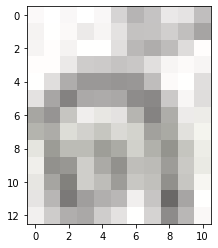

1 อ 112 518 9 16


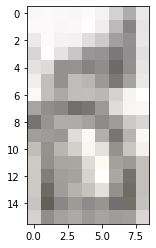

1 ื 0 0 998 601


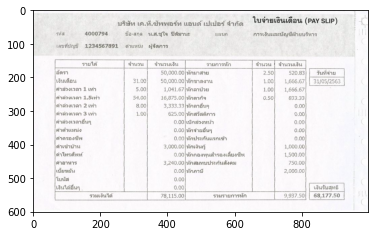

1 ่ 121 525 11 9


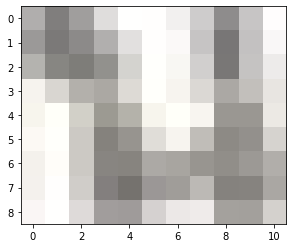

1 น 0 0 998 601


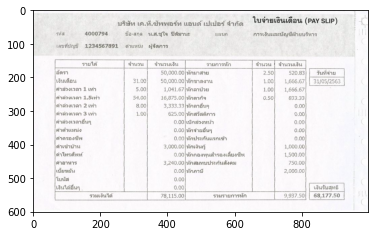

1 ๆ 132 525 7 12


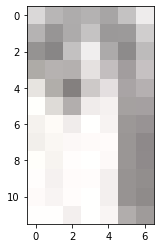

4 0.00 420 522 30 13


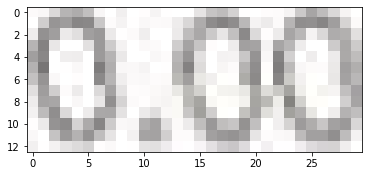

2 เง 837 525 5 9


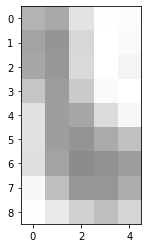

1 ิ 842 521 8 13


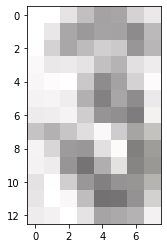

1 น 851 525 10 9


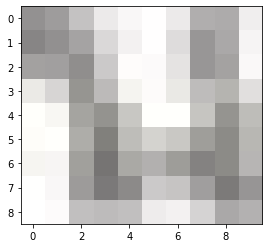

1 ร 0 0 998 601


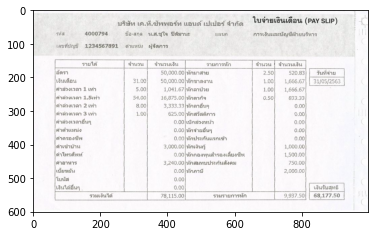

1 ั 862 520 9 14


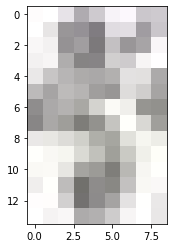

1 บ 869 524 10 10


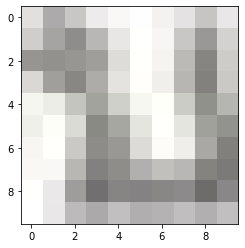

1 ส 0 0 998 601


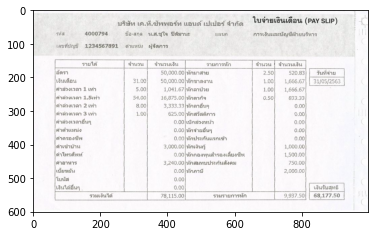

1 ุ 0 0 998 601


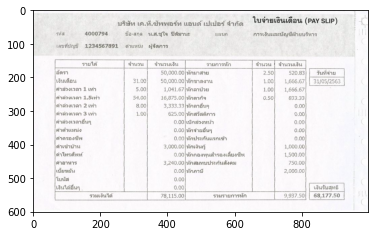

1 ท 880 523 20 14


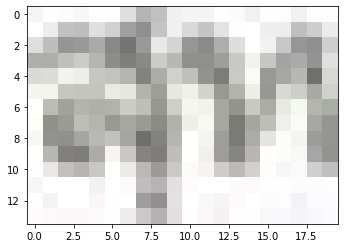

2 ธิ 901 521 9 13


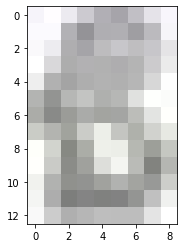

1 ร 0 0 998 601


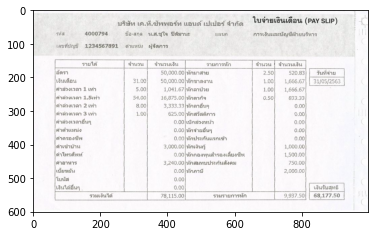

1 ว 169 549 15 9


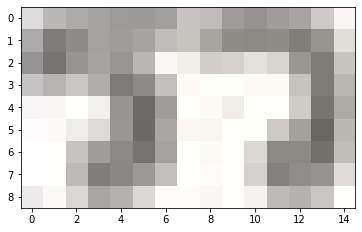

1 ม 0 0 998 601


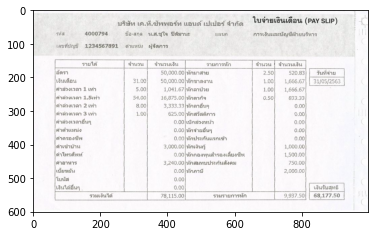

2 เง 185 549 14 9


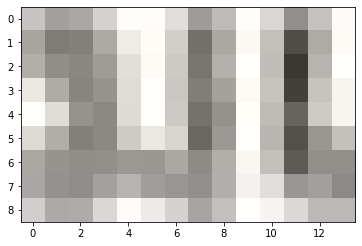

1 ิ 200 545 8 13


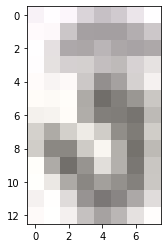

1 น 0 0 998 601


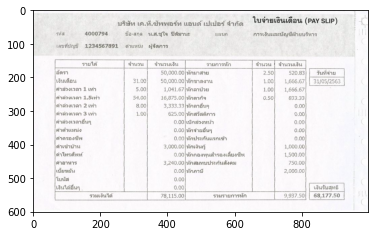

2 ได 209 545 18 13


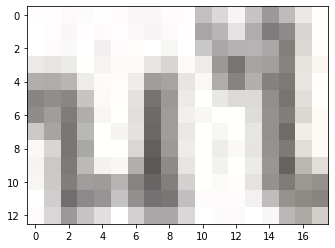

1 ้ 228 545 9 13


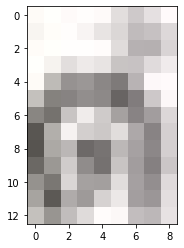

10 78,115.00| 382 547 68 14


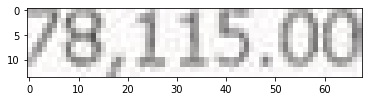

1 ร 0 0 998 601


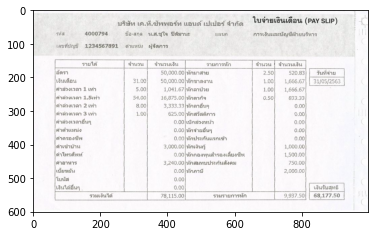

1 ว 537 549 7 9


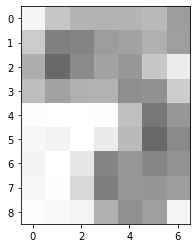

1 ม 545 549 17 9


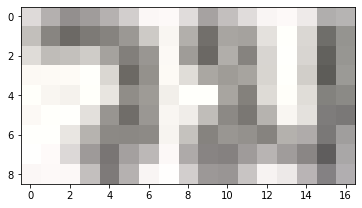

1 ร 0 0 998 601


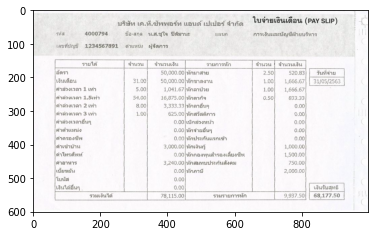

1 า 563 549 15 9


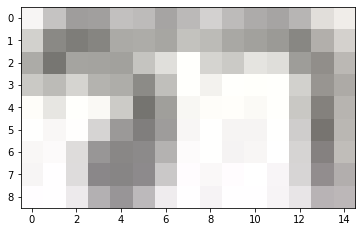

1 ย 0 0 998 601


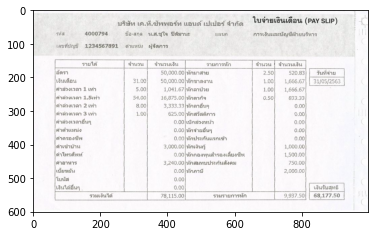

1 ก 580 549 8 9


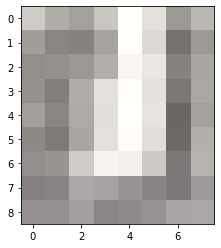

1 า 589 549 10 9


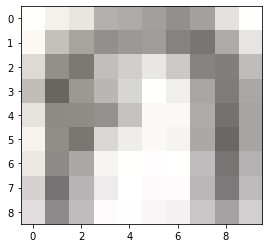

1 ร 600 549 7 9


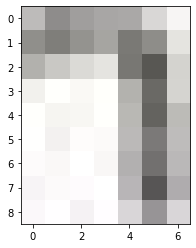

1 ห 608 545 17 13


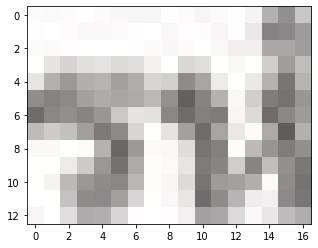

1 ั 0 0 998 601


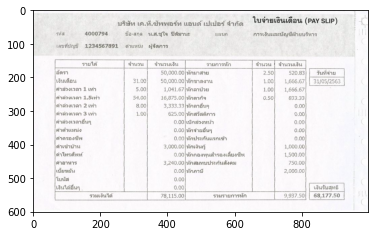

1 ก 626 545 10 13


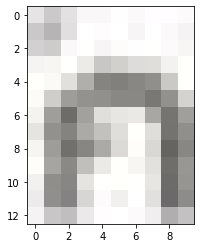

9 9,537.50| 749 546 60 14


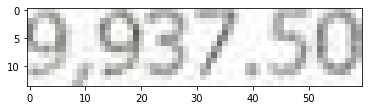

1 | 0 0 998 601


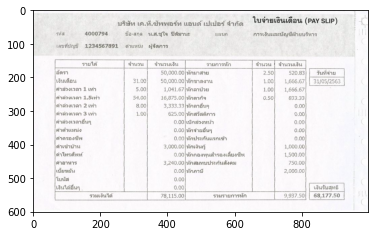

9 68,177.50 836 546 78 15


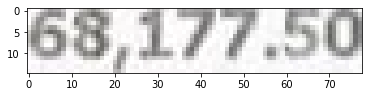

1   453 148 2 415


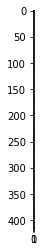

1   340 148 2 418


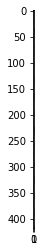

1   719 148 2 414


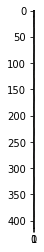

1   812 149 2 416


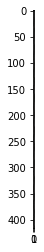

1   823 515 1 49


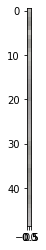

1   926 519 2 46


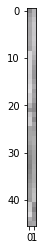

0  65 563 863 3


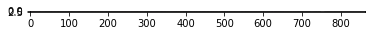

In [ ]:
for i in range(len(d['text'])):
    if float(d['conf'][i]) < 0.6 and len(d['text'][i]) == 0:
        continue
    left, top, width, height = d['left'][i], d['top'][i], d['width'][i], d['height'][i]
    print(len(d['text'][i]), d['text'][i], left, top, width, height)
    plt.imshow(image[top:top+height, left:left+width, :])
    plt.show()


In [ ]:
dir(pytesseract)

['ALTONotSupported',
 'Output',
 'TSVNotSupported',
 'TesseractError',
 'TesseractNotFoundError',
 '__builtins__',
 '__cached__',
 '__doc__',
 '__file__',
 '__loader__',
 '__name__',
 '__package__',
 '__path__',
 '__spec__',
 '__version__',
 'get_languages',
 'get_tesseract_version',
 'image_to_alto_xml',
 'image_to_boxes',
 'image_to_data',
 'image_to_osd',
 'image_to_pdf_or_hocr',
 'image_to_string',
 'pytesseract',
 'run_and_get_output']